# Universidad de Buenos Aires
# Aprendizaje Profundo - TP1
# Cohorte 22 - 5to bimestre 2025


Este primer TP comienza la semana de la clase 2 y la ventana de entrega estará abierta hasta las **23hs del viernes 14 de noviembre (hora de Argentina)**. La resolución del TP es **individual**. Pueden utilizar tanto los contenidos vistos en clase, como otra bibliografía externa. Si se toman ideas de fuentes externas deben ser correctamente citadas incluyendo el correspondiente link o página de libro.

ESTE TP1 EQUIVALE AL 33.33% DE SU NOTA FINAL.

El formato de entrega debe ser un link a un notebook de google colab. Importante permitir acceso a gvilcamiza.ext@fi.uba.ar y **habilitar los comentarios, para poder darles el feedback**. Si no lo hacen así no se podrá dar el feedback respectivo por cada pregunta.

El envío **se realizará en el siguiente link de google forms: [link](https://forms.gle/98W6TBHjyWnwAzTB9)**. Tanto los resultados, gráficas, como el código y las explicaciones deben quedar guardados y visualizables en el colab.

**NO SE VALIDARÁN ENVÍOS POR CORREO, EL MÉTODO DE ENTREGA ES SOLO POR EL FORMS.**

**Consideraciones a tener en cuenta:**
- Se entregará 1 solo colab para este TP1.
- Renombrar el archivo de la siguiente manera: **APELLIDO-NOMBRE-DL-TP1-Co22.ipynb**
- Los códigos deben poder ejecutarse.
- **IMPORTANTE:** Los resultados, cómo el código, los gráficos, los prints y las explicaciones deben quedar guardados y visualizables en el mismo notebook.
- **Prestar mucha atención a cada consigna, responder las preguntas justo debajo del enunciado que corresponda.**
- Solo se revisarán los trabajos que hayan sido enviados por el forms.

# **PREGUNTA 1** (Temas de la clase 1 y 2)

## **Comparación de Gradiente Descendente y Adam en una Función de Costo No Convexa**

En este ejercicio se compararán los optimizadores Gradiente Descendente (GD) y Adam en la minimización de una función de costo basada en una red neuronal de una sola neurona:
$$
z = w x + b
$$
Con función de activación tangente hiperbólica:

$$
\hat{y} = a(z) = \tanh(z) = \tanh(w x + b)
$$

<br>

Se analizará la trayectoria de aprendizaje de ambos algoritmos y se evaluará su eficiencia con diferentes tasas de aprendizaje (learning rate).

<br>

La función de costo utilizada es el Error Cuadrático Medio (MSE):

$$
J(w, b) = \frac{1}{m} \sum_{i=1}^{m} (\hat{y}_i - y_i)^2
$$

$$
J(w, b) = \frac{1}{m} \sum_{i=1}^{m} ( \tanh(w x_i + b) - y_i )^2
$$

donde \\( w \\) y \\( b \\) son los parámetros a optimizar.

<br>

Si bien es cierto, en estos experimentos estamos comparando optimizadores (GD vs Adam), y no entrenando un modelo como tal, de igual forma se necesitará una especie de dataset. Este será sintético y solo de prueba, por ende tendrán cierta libertad para elegir sus valores. Sin embargo deberán tomar en cuenta que cumpla la siguiente estructura:

`x = np.linspace(ini, fin, n)`

donde `x` es un array de una sola dimensión y con `n` cantidad de valores ($n>=200$). Y tiene un rango de valores desde `ini` hasta `fin`. Recomiendo que sea simétrico, es decir, los mismos valores solo que con el signo cambiado, por ejemplo `ini=-3, fin=3`.

<br>

Y con un target `y`:

`y = funcion_no_lineal(x) + ruido`

donde `y` es también un vector de una sola dimensión de tamaño `n` que sigue un patrón no lineal (elegido por ustedes) con respecto a `x` adicionando un ruido que puede ser creado con algunas de las funciones del paquete `np.random`.

El patrón no lineal puede ser una función trigonométrica, exponencial, logarítmica, sigmoidal o polinómica de grado mayor o igual a 3.

### 1a) Implementación del Gradiente Descendente (1 punto)
- Implementar el algoritmo del Gradiente Descendente (GD) para minimizar \\( J(w, b) \\).
- Utilizar 100 épocas y 3 diferentes learning rates `(0.1, 0.01, 0.001)`.
- Inicializar valores de \\( w \\) y \\( b \\) de manera aleatoria con `np.random.randn()`.
- Graficar la función de Costo \\( J(w, b) \\) VS número de época para comparar cómo converge la función para los 3 learning rates.

<br>

El optimizador del Gradiente Descendente se debe implementar haciendo el código desde cero y paso a paso. Se pueden usar librerías como `numpy`, `scipy`, `matplotlib` o similares. Pero no está permitido usar Pytorch ni TensorFlow o frameworks que ya contengan el optimizador desarrollado.

In [4]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML, display
import seaborn as sns
import sklearn
import torch

Iniciemos definiendo la función a encontrar. Utilizamos una función `tanh`, ya que al ser una red con 1 capa de 1 neurona con función de activación `tanh`, esta será la función que se pueda representar de manera exitosa. Otros casos como la sigmoide sería un problema de encontrar la función que minimice le error, pero no podremos representar bien la función objetivo.

Definimos entonces la función, y en pos de tener reproducibilidad en los resultados, establecemos un estado aleatorio `rnd_state=np.random.RandomState(190723182)` (el número es "aleatorio", pero se busco que se inicie con la solución inicial apuntando al reves que los datos).

Luego definimos los a y b de la ecuación a optimizar, y los `w_0` y `b_0` origen de nuestros algorítmos. Los establecemos en esta etapa de forma que sean los mismos para todos los algorítmos y sea una comparación justa.

a=-1.598223004910507 ; b=-0.3037727229467504
w_0=1.6239101832517715 ; b_0 = 0.3236416985671413


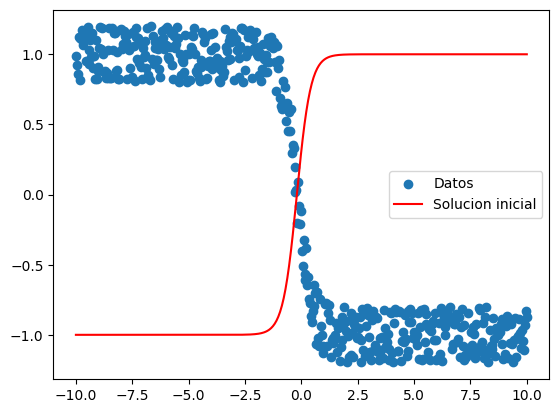

In [9]:
# Definamos primero el dataset
x = np.linspace(-10,10,500)
# x = np.linspace(-3,3,100)
# Hagamos la función no lineal como la tangente hiperbólica
rnd_state = np.random.RandomState(190723182)
a1, a2 = rnd_state.uniform(-2,high=2,size=2)
print(f"a={a1} ; b={a2}")
error = rnd_state.uniform(low=-0.2,high=0.2,size=x.shape[0])
y = np.tanh(a1*x + a2) + error
y_noerror = np.tanh(a1*x + a2)
plt.scatter(x,y, label='Datos')

w_0, b_0 = rnd_state.uniform(-2,high=2,size=2)
print(f"w_0={w_0} ; b_0 = {b_0}")
plt.plot(x, np.tanh(w_0*x+b_0), label='Solucion inicial', color='r')

plt.legend()

Comencemos con la implementación del algorítmo de gradient descent.

Tenemos que la función de pérdida viene dada por: 
$$
J(\theta) = \frac{1}{m} \sum (\hat{y}_i - y)^2
$$
Y la función de predicción es:
$$
\hat{y} = \tanh(w\cdot x + b)
$$
Queremos obtener el gradiente:
$$
\nabla_\theta J(\theta) = \begin{bmatrix}
    \cfrac{\partial J}{\partial w} \\
    \cfrac{\partial J}{\partial b}
\end{bmatrix}
$$
Si hacemos backpropagation tenemos que:
$$
\frac{\partial J}{\partial \theta_i} = \sum_j \frac{\partial J}{\partial \hat{y}_j} \frac{\partial \hat{y}_j}{\partial z_j} \frac{\partial z_j}{\partial \theta_i}
$$
Aclaración: se usa $z$ para denotar $w\cdot x + b$ y hacer más fáciles las derivadas.<br>
Calculemos las derivadas parciales:
$$
\begin{gather*}
\frac{\partial J}{\partial \hat{y}} = \frac{2}{m} (\hat{y} - y) \\
\frac{\partial \hat{y}}{\partial z} = \frac{1}{\cosh^2(z)} \\
\frac{\partial z}{\partial w} = x \\ 
\frac{\partial z}{\partial b} = 1
\end{gather*}
$$
Entonces tenemos:
$$
\begin{gather*}
\frac{\partial J}{\partial w} = \sum_j \frac{2}{m} (\hat{y}_j - y) \cdot \frac{1}{\cosh^2(z_i)} \cdot x \\
\frac{\partial J}{\partial b} = \sum_j \frac{2}{m} (\hat{y}_j - y) \cdot \frac{1}{\cosh^2(z_i)} \cdot 1
\end{gather*}
$$
Y $w$ y $b$ se actualizan por:
$$
\begin{gather*}
w_i = w_{i-1} + \alpha \, \frac{\partial J}{\partial w} \\
b_i = w_{b-1} + \alpha \, \frac{\partial J}{\partial b}
\end{gather*}
$$

A continuación podemos ver lo explicado previamente aplicado a una clase de python.

In [6]:
class GradientDescent():
    def __init__(self, x, y, theta, learning_rate=0.001):
        self.learning_rate = learning_rate
        self.it = 1
        self.loss = 10 # inicio con un valor "alto"
        self.theta = theta
        self.x = x
        self.y = y
        self.y_hat = np.ones(self.x.shape)

    def predict(self):
        self.y_hat = np.tanh(self.theta[0] * self.x + self.theta[1])

    def update_gradient(self):
        z = self.theta[0] * self.x + self.theta[1]

        # dy/dz
        dydz = 1 / (np.cosh(z) ** 2)
        
        # dy_hat / dtheta
        dyhat_dtheta = np.column_stack((
            self.x,
            np.ones(x.shape)
        )) * dydz.reshape(-1,1)

        # dJ_dtheta
        self.gradient = np.mean(2 * (self.y_hat - self.y) * dyhat_dtheta.transpose(), axis=1)

    def update_loss(self):
        self.loss = np.mean((self.y - self.y_hat) ** 2)
    
    def iteration(self):
        # update gradient
        self.update_gradient()

        # update theta
        self.theta = self.theta - self.learning_rate * self.gradient

        # predict y and update loss
        self.predict()
        self.update_loss()

    def optimize(self, epochs=1000):
        self.predict()
        self.update_loss()
        self.loss_path = [self.loss]
        self.theta_path = [[self.theta[0]], [self.theta[1]]]
        while (self.it < epochs+1):
            self.iteration()
            self.loss_path.append(self.loss)
            self.theta_path[0].append(self.theta[0])
            self.theta_path[1].append(self.theta[1])
            self.it += 1

Realicemos entonces optimización por Gradient Descent para 3 learning rates distintos.

In [7]:
gd_ops = []
for lr in [0.1, 0.01, 0.001]:
    gd_optimizer = GradientDescent(x=x, y=y, theta=np.array([w_0,b_0]), learning_rate=lr)
    gd_optimizer.optimize(epochs=100)
    print(f"lr = {lr}; Final total loss = {gd_optimizer.loss}")
    gd_ops.append(gd_optimizer)

lr = 0.1; Final total loss = 0.03224796638798444
lr = 0.01; Final total loss = 3.7754628572366378
lr = 0.001; Final total loss = 3.781356824747858


Observamos que el learning rate de 0.1 dio valores de pérdida bajos, mientras que los más bajos dieron valores altos similares.<br>
A continuación vemos las 3 soluciones graficadas.

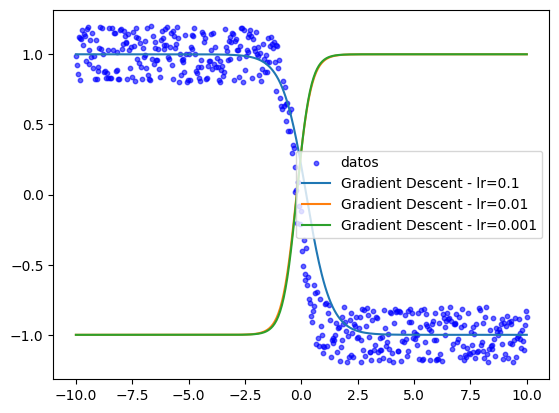

In [198]:
plt.scatter(x,y, label='datos', color='blue', alpha=0.6, s=10)
for gd_optimizer in gd_ops:
    plt.plot(x, gd_optimizer.y_hat, label=f'Gradient Descent - lr={gd_optimizer.learning_rate}')
plt.legend()

Se observa que al comenzar con una solución inicial "dada vuelta", el algorítmo necesita varias iteraciones (o menor learning rate) para lograr dar vuelta la función. Esto se debe a que los `w` de solución y de inicialización tiene signos opuestos

### 1b) Implementación de Adam (2 punto)  
- Implementar el algoritmo de Adam para minimizar \\( J(w, b) \\).  
- Utilizar 100 épocas y 3 diferentes learning rates `(0.1, 0.01, 0.001)`.
- Utilizar los mismos valores de \\( w \\) y \\( b \\) que se usaron para GD.
- Hacer 2 modelos, uno sin mini-batch (full-batch) y otro con mini-batch.
- El batch size es a elección de ustedes, pero debe ser mayor o igual a 16.
- Graficar la función de Costo \\( J(w, b) \\) VS número de época para comparar cómo converge la función para ambos modelos y para los 3 learning rates.

<br>

Al igual que para GD, el optimizador Adam también se debe implementar desde cero y paso a paso. Se pueden usar librerías como `numpy`, `scipy`, `matplotlib` o similares. Pero no está permitido usar Pytorch ni TensorFlow o frameworks que ya contengan el optimizador desarrollado.

#### Respuesta
En [1] se presenta el algorítmo Adam para optimización de funciones. El mismo presenta la siguiente estructura:
Los parámetros se actualizan según: 
$$
\theta_t = \theta_{t-1} - \frac{\alpha\,\hat{m}_t}{\sqrt{\hat{v}_t} + \epsilon}
$$
donde:
- $\alpha$ es el *stepsize* o *learning rate*.
- $\hat{m}_t$ es el estimador del primer momento corregido por bias
- $\hat{v}_t$ es el estimador del segundo momento corregido por bias
- $\epsilon$ es un valor muy chico para evitar dividir por 0

Los estimadores del primer y segundo momento corregidos por bias se obtienen de:
$$
\begin{gather*}
\hat{m}_t = \frac{m_t}{1-\beta^t_1} \\
m_t = \beta_1\cdot m_{t-1} + (1-\beta_1) \cdot \nabla_\theta f_t(\theta_{t-1}) \\
\hat{v}_t = \frac{m_t}{1-\beta^t_2} \\
v_t = \beta_2\cdot v_{t-1} + (1-\beta_2) \cdot [\nabla_\theta f_t(\theta_{t-1})]^2
\end{gather*}
$$
siendo $m_t$ y $v_t$ los estimadores del primer y segundo momento sin corrección de bias.

Con esto podemos definir las funciones necesarias para implementar el optimizador por Adam.

Al aplicar el algorítmo en modalidad mini-batch, la única diferencia es que en lugar de calcular la pérdida, actualizar los momentos y luego actualizar los parámetros para todos los datos, esto se hace para distintos batches del total de datos, de forma en serie. Al comenzar una nueva epoch se realiza una nueva selecciones de batches y se actualizan de forma secuencial los parámetros.

A continuación se tiene la clase de python que implementa este algorítmo.

[1] Adam: A Method for Stochastic Optimization. Diederik Kingma y Jimmy Lei Ba.

In [11]:
class Adam(GradientDescent):
    def __init__(self, x, y, theta, learning_rate=0.001, beta_1=0.9, beta_2=0.999, eps=1E-6, batch_size=0):
        # inicializo lo mismo que para GradientDescent
        super().__init__(x=x, y=y, theta=theta, learning_rate=learning_rate)

        # inicializo las cosas particulares de Adam
        self.beta_1 = beta_1
        self.beta_2 = beta_2
        self.eps = eps
        self.m = np.zeros(self.theta.shape) # 1st moment biased estimate
        self.v = np.zeros(self.theta.shape) # 2nd moment biased estimate 
        self.m_hat = np.zeros(self.theta.shape) # 1st moment corrected estimate
        self.v_hat = np.zeros(self.theta.shape) # 2nd moment corrected estimate
        self.batch_size = batch_size if batch_size != 0 else self.x.shape[0]
        self.y_hat = np.ones(self.batch_size)
        self.epochs = 0
    
    # se heredan de GradientDescent sin modificaciones:
    #   - update_loss

    def predict(self, x):
        self.y_hat = np.tanh(self.theta[0] * x + self.theta[1])

    def update_gradient(self, x, y):
        z = self.theta[0] * x + self.theta[1]

        # dy/dz
        dydz = 1 / (np.cosh(z) ** 2)
        
        # dy_hat / dtheta
        dyhat_dtheta = np.column_stack((
            x,
            np.ones(x.shape)
        )) * dydz.reshape(-1,1)

        # dJ_dtheta
        self.gradient = np.mean(2 * (self.y_hat - y) * dyhat_dtheta.transpose(), axis=1)

    def update_loss(self, y):
        self.loss = np.mean((y - self.y_hat) ** 2)

    def update_m(self):
        self.m = self.beta_1 * self.m + (1 - self.beta_1) * self.gradient
        self.m_hat = self.m / (1-self.beta_1**self.it)
    
    def update_v(self):
        self.v = self.beta_2 * self.v + (1 - self.beta_2) * self.gradient**2
        self.v_hat = self.v / (1-self.beta_2**self.it)

    def iteration(self, x, y):
        # predict y and update loss
        self.predict(x)
        self.update_loss(y)

        # update gradient
        self.update_gradient(x, y)

        # update moments
        self.update_m()
        self.update_v()

        # update theta
        self.theta = self.theta - self.learning_rate * self.m_hat / (np.sqrt(self.v_hat) + self.eps)
    

    def make_batches(self):
        all_idxs = np.arange(self.x.shape[0])
        self.batches = []
        while all_idxs.shape[0] > 0:
            if self.batch_size < all_idxs.shape[0]:
                idxs = np.random.choice(all_idxs.shape[0], self.batch_size, replace=False) # choose batch_size indexes at random
            else:
                idxs = np.arange(all_idxs.shape[0])
            x = np.array([self.x[all_idxs[i]] for i in idxs])
            y = np.array([self.y[all_idxs[i]] for i in idxs])
            self.batches.append([x,y])
            all_idxs = np.delete(all_idxs, idxs)

    def optimize(self, epochs=1000):
        # self.make_batches()

        # predict for all x
        self.predict(self.x)
        # calculate full loss
        self.update_loss(self.y)

        self.loss_path = [self.loss]
        self.theta_path = [[self.theta[0]], [self.theta[1]]]

        while (self.epochs < epochs):
            self.make_batches()

            for batch in self.batches:
                self.iteration(batch[0], batch[1])
                self.it += 1

            if self.batch_size > 1:
                # predict and calculate loss for full-batch
                self.predict(self.x)
                self.update_loss(self.y)
            self.loss_path.append(self.loss)
            self.theta_path[0].append(self.theta[0])
            self.theta_path[1].append(self.theta[1])
            self.epochs += 1

        # predict for all x
        self.predict(self.x)
        # calculate full loss
        self.update_loss(self.y)

A continuación aplicamos el algorítmo en modalidad full-batch y mini-batch.

In [12]:
adam_full_batch = []
adam_mini_batch = []

for lr in [0.1, 0.01, 0.001]:
    adam_optimizer_full_batch = Adam(x=x, y=y, theta=np.array([w_0,b_0]), learning_rate=lr)
    adam_optimizer_full_batch.optimize(epochs=100)
    print(f"Adam full-batch ; lr = {lr} ; Final total loss = {adam_optimizer_full_batch.loss}")
    adam_full_batch.append(adam_optimizer_full_batch)

    adam_optimizer_mini_batch = Adam(x=x, y=y, theta=np.array([w_0,b_0]), learning_rate=lr, batch_size=20)
    adam_optimizer_mini_batch.optimize(epochs=100)
    print(f"Adam mini-batch ; lr = {lr} ; Final total loss = {adam_optimizer_mini_batch.loss}")
    adam_mini_batch.append(adam_optimizer_mini_batch)


Adam full-batch ; lr = 0.1 ; Final total loss = 0.014831198400383112
Adam mini-batch ; lr = 0.1 ; Final total loss = 0.01483626501980553
Adam full-batch ; lr = 0.01 ; Final total loss = 2.0509599581208233
Adam mini-batch ; lr = 0.01 ; Final total loss = 0.0152686423272736
Adam full-batch ; lr = 0.001 ; Final total loss = 3.7722801376109825
Adam mini-batch ; lr = 0.001 ; Final total loss = 0.0515037391051001



Observamos que el modelo mini-batch disminuye considerablemente la pérdida para los 3 learning rates, aunque el de `lr` más bajo parece no tener un valor de pérdida tan bajo como el resto.<br>
El modelo full-batch tiene resultados similares a Gradient Descent, logrando una pérdida satisfactoria para el learning rate más alta, pero insatisfactoria para el resto.

### 1c) Comparativa de optimizadores (0.5 puntos)  
- Comparar el resultado y rendimiento de GD VS Adam (full-batch) VS Adam (mini-batch) para cada uno de los learning rates por separado. Hacerlo con gráficas y tablas.
- Redactar conclusiones analíticas que resalten las diferencias entre cada optimizador.

#### Respuesta
Veamos en primer lugar a continuación la solución de cada algorítmo para cada learning rate. Además graficamos la que sería la "solución", es decir los datos antes de aplicarles el error que genera la dispersión.<br>
Observamos que para `learning_rate=0.1` obtenemos una solución casi perfecta para Adam mini-batch y full-batch, mientras que Gradient Descent no obtiene bien la solución, pareciendo que faltan iteraciones.<br>
Para `learning_rate=0.01` el único que siquiera muestra una forma similar a la solución es Adam mini-batch, además de que nuevamente logra una solución correcta. Para Adam full-batch y gradient descent observamos una forma de solución que no tiene nada que ver con los datos. Esto se debe a que la inicialización de `w` y `b` es pobre (puede pasar dada la aleatoreidad de su selección), y combinado a un `learning_rate` bajo, no logra llevar los valores a algo cercano a la solución dentro del número de epochs permitido.<br>
Por último, para `learning_rate=0.001` Adam mini-batch no lgora representar de manera perfecta la solución, aunque si tiene una forma similar. En cuanto a Adam full-batch y gradient descent ocurre lo mismo que en el caso anterior.

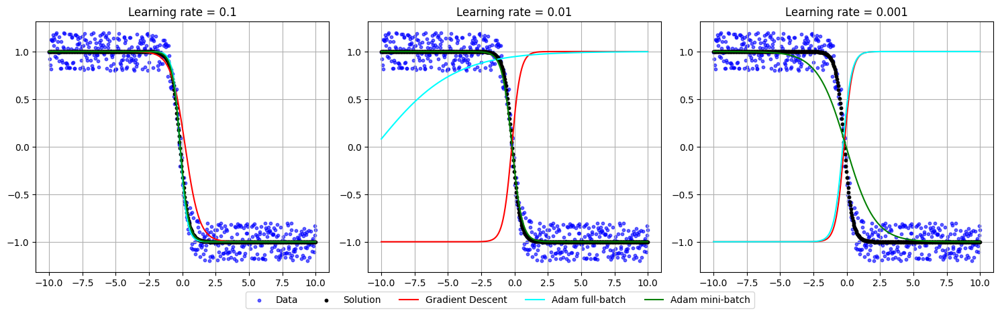

In [201]:
learning_rates = [0.1, 0.01, 0.001]
fig, axs = plt.subplots(1,3, figsize=(15,4.5))
for i in range(3):
    axs[i].scatter(x,y, label='Data', color='blue', alpha=0.6, s=10)
    axs[i].scatter(x, y_noerror, label='Solution', color='black', zorder=2, s=10)
    axs[i].plot(x, gd_ops[i].y_hat, label='Gradient Descent', color='red')
    axs[i].plot(x, adam_full_batch[i].y_hat, label='Adam full-batch', color='cyan')
    axs[i].plot(x, adam_mini_batch[i].y_hat, label='Adam mini-batch', color='green')
    #axs[i].legend()
    axs[i].set_title(f"Learning rate = {learning_rates[i]}")
    axs[i].grid()
handles, labels = axs[-1].get_legend_handles_labels()
fig.legend(
    handles, labels,
    loc = 'lower center', ncol=len(labels),
    bbox_to_anchor=(0.5,-0.05)
)
fig.tight_layout()

A continuación tenemos el valor final del error o pérdida para cada algorítmo y para cada `learning_rate`, y también la evolución de la pérdida con los epochs para cada algorítmo y cada `learning_rate`.<br>
En primer lugar observamos que los 2 casos satisfactorios de Adam mini-batch tienen pérdida del orden de 0.01, y que pérdidas ya menores a 0.5 muestran la forma de la solución, pero no se obtiene la solución correcta si no se llega al orden mencionado previamente. Además se ve claramente como los valores de pérdida de los casos insatisfactorios son muy altos.<br>
En cuanto a la evolución de la pérdida observamos como Adam mini-batch con `learning_rate=0.1` obtiene la solución muy rápidamente, en menos de 3 epochs. Luego el mismo algorítmo para `learning_rate=0.01` llega a la solución en alrededor de 50-60 epochs, con un avance más lento. Y para `learning_rate=0.001` se ve que está con una tendencia descendiente, pero se corta el proceso por llegar a la máxima cantidad de epochs permitidos.<br>
Para Adam full-batch en el caso de `learning_rate=0.1` podemos ver como llega a un valor satisfactorio de pérdida de manera suave, mientras que para los otros casos no avanza lo suficientemente rápido hacia la solución.<br>
Gradient descent muestra un avance muy lento aún en el caso de `learning_rate=0.1`, lo cual podría indicar que producto de la inicialización se encontró en un punto con valores de gradiente bajos que no le permiten avanzar. Se observa que para alrededor de 70 epochs logra romper una barrera y empieza a bajar de forma más constante la pérdida. Para los otros casos no avanza practicamente nada de la inicialización.

In [202]:
results = {}
results['learning rate'] = learning_rates
results['gradient descent'] = [opt.loss for opt in gd_ops]
results['adam full batch'] = [opt.loss for opt in adam_full_batch]
results['adam mini batch'] = [opt.loss for opt in adam_mini_batch]
results = pd.DataFrame(results)
results

,learning rate,gradient descent,adam full batch,adam mini batch
0,0.100,0.032248,0.014831,0.014675
1,0.010,3.775463,2.050960,0.015111
2,0.001,3.781357,3.772280,0.051451


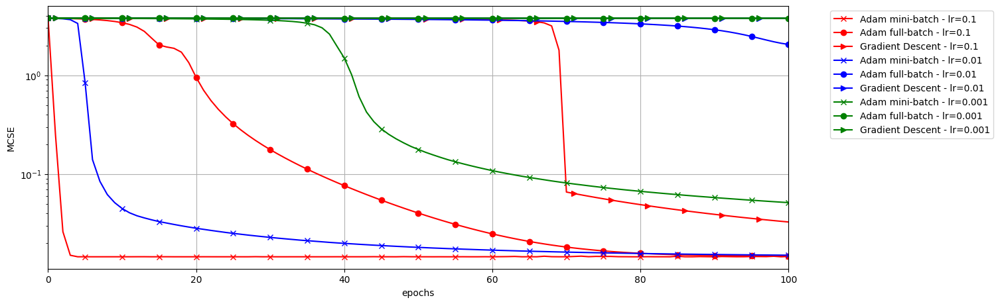

In [203]:
fig, ax = plt.subplots(figsize=(15,4.5))
colors = ['red', 'blue', 'green']
for i in range(3):
    color = colors[i]
    plt.plot(range(0,adam_mini_batch[i].epochs+1),  adam_mini_batch[i].loss_path,   label=f'Adam mini-batch - lr={learning_rates[i]}',   marker='x', markevery=5, color=color)
    plt.plot(range(0,adam_full_batch[i].epochs+1),  adam_full_batch[i].loss_path,   label=f'Adam full-batch - lr={learning_rates[i]}',   marker='o', markevery=5, color=color)
    plt.plot(range(1,gd_ops[i].it+1),               gd_ops[i].loss_path,            label=f'Gradient Descent - lr={learning_rates[i]}',  marker='>', markevery=5, color=color)
plt.yscale('log')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.xlim(0,100)
plt.xlabel('epochs')
plt.ylabel('MCSE')
plt.grid()

A continuación podemos ver la evolución de los parámetros `w` y `b`. En líneas a rayas se pueden ver los valores "solución" con los que se generó originalmente la distribución de datos.<br>
Observamos que en el caso de `learning_rate=0.1`, Adam mini-batch logra establecer los valores de los parámetros rápidamente y luego oscila al rededor de los mismos, mientras que Adam full-batch tiene valores ya cercanos a los correctos pero aún no estables. Además Gradient descent se encuentra cercano a los valores solución, pero le faltan epochs por recorrer. <br>
Para el caso de `learning_rate=0.01` Adam mini-batch ya tiene los 2 parámetros cerca de la solución hacia el final de la optimización, mientras que tanto Adam full-batch como gradient descent se encuentran lejos de la solución, aunque Adam full-batch está realizando cambios en los parámetros, mientras que GD está estable sin modificarlos casi.<br>
Por último, para `leraning_rate=0.001`, Adam mini-batch tiene el valor de `b` acercandose a la solución pero aún no en la misma, mientras que el valor de `b` aún está lejos pero con tendencia correcta. Esto se puede ver también en el caso anterior de Adam mini-batch. Los otros 2 algorítmos tienen modificaciones leves en los parámetros, aún lejos de la solución.


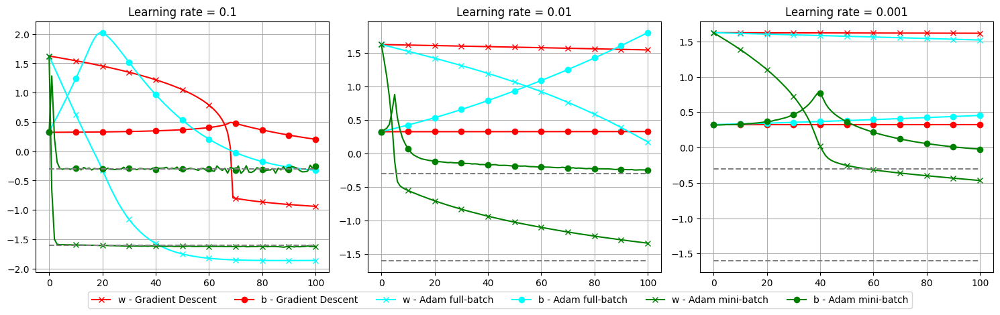

In [205]:
fig, axs = plt.subplots(1,3, figsize=(15,4.5))
for i in range(3):
    axs[i].plot(range(0, gd_ops[i].it), gd_ops[i].theta_path[0], label='w - Gradient Descent', color='red', marker='x', markevery=10)
    axs[i].plot(range(0, gd_ops[i].it), gd_ops[i].theta_path[1], label='b - Gradient Descent', color='red', marker='o', markevery=10)
    axs[i].plot(range(0, adam_full_batch[i].epochs+1), adam_full_batch[i].theta_path[0], label='w - Adam full-batch', color='cyan', marker='x', markevery=10)
    axs[i].plot(range(0, adam_full_batch[i].epochs+1), adam_full_batch[i].theta_path[1], label='b - Adam full-batch', color='cyan', marker='o', markevery=10)
    axs[i].plot(range(0, adam_mini_batch[i].epochs+1), adam_mini_batch[i].theta_path[0], label='w - Adam mini-batch', color='green', marker='x', markevery=10)
    axs[i].plot(range(0, adam_mini_batch[i].epochs+1), adam_mini_batch[i].theta_path[1], label='b - Adam mini-batch', color='green', marker='o', markevery=10)
    #axs[i].legend()
    axs[i].hlines(y=[a1,a2], xmin=0, xmax=100, colors=['grey', 'grey'], linestyles=['--', '--'])
    axs[i].set_title(f"Learning rate = {learning_rates[i]}")
    axs[i].grid()
handles, labels = axs[-1].get_legend_handles_labels()
fig.legend(
    handles, labels,
    loc = 'lower center', ncol=len(labels),
    bbox_to_anchor=(0.5,-0.05)
)
fig.tight_layout()

### 1d) Visualización en 3D de la trayectoria de aprendizaje (0.5 puntos)
- Graficar en 3D la trayectoria del aprendizaje de los 3 optimizadores sobre la superficie de la función de costo \\( J(w, b) \\). Se debe elegir un solo learning rate.
- Comparar y redactar cómo se mueven en el espacio de parámetros y qué diferencias existen en la convergencia.
- Recomiendo utilizar `mpl_toolkits.mplot3d` y `np.meshgrid`, pero queda a su criterio la elección de funciones a usar para lograr el gráfico.

A continuación se tiene en 3D la trayectoria de aprendizaje de los 3 optimizadores.<br>
Se ve de forma clarísima que se tiene una frontera por superar en `w`, y que el punto de partida es un punto dentro de una zona casi plana. Esto valida los resultados de Gradient Descent.<br>
Se ve muy claramente la rapidez de convergencia de Adam mini-batch y como se queda oscilando cerca de la solución.<br>
Por último vemos como Adam full-batch hace un camino diferente a su hermano mini-batch, haciendo una trayectoria más larga.

In [211]:
def surface3d(w_true, b_true, w_org, b_org, pad_w=1.5, pad_b=1.5):
    wmin, wmax = min(w_org, w_true) - pad_w, max(w_org, w_true) + pad_w
    bmin, bmax = min(b_org, b_true) - pad_b, max(b_org, b_true) + pad_b

    W = np.linspace(wmin, wmax, 140)
    B = np.linspace(bmin, bmax, 140)
    WW, BB = np.meshgrid(W, B)
    JJ = np.zeros_like(WW)
    for i in range(WW.shape[0]):
        yhat_grid = np.tanh(WW[i][None, :] * x[:, None] + BB[i][None, :])
        JJ[i] = np.mean((y[:, None] - yhat_grid) ** 2, axis=0)


    surf = ax3d.plot_surface(WW, BB, JJ, alpha=0.82, linewidth=0, antialiased=True)
    ax3d.set_xlabel("w")
    ax3d.set_ylabel("b")
    ax3d.set_zlabel("J(w,b)")
    ax3d.view_init(elev=30, azim=45)
    ax3d.set_xlim(wmin, wmax)
    ax3d.set_ylim(bmin, bmax)
    ax3d.set_zlim(0, JJ.max() * 1.05)

    # ax3d.scatter([path_w[0]], [path_b[0]], [path_J[0]], s=60, c="orange", marker="x")

    cs = ax2d.contourf(WW, BB, JJ, levels=30)
    ax2d.contour(WW, BB, JJ, levels=15, colors="k", linewidths=0.4, alpha=0.6)
    ax2d.set_xlabel("w")
    ax2d.set_ylabel("b")
    ax2d.set_xlim(wmin, wmax)
    ax2d.set_ylim(bmin, bmax)

def make_animation(fig, ax3d, ax2d, paths_J, paths_w, paths_b, labels, colors):
    trails3d, points3d = [], []
    trails2d, points2d = [], []
    for j in range(len(paths_J)):
        trail3d, = ax3d.plot([], [], [], lw=2, color=colors[j], label=labels[j])
        trails3d.append(trail3d)
        points3d.append(ax3d.scatter([], [], [], s=60, c="red"))

        trail2d, = ax2d.plot([], [], lw=2, color=colors[j], label=labels[j])
        trails2d.append(trail2d)
        point2d, = ax2d.plot([], [], marker="o", markersize=6, color="red")
        points2d.append(point2d)

    info_string = "\n".join([
        f"{label}: J(w,b) = {path_J[0]:.6f}   |   w = {path_w[0]:.4f}, b = {path_b[0]:.4f}   |   lr = {lr}"
        for label, path_J, path_w, path_b in zip(labels, paths_J, paths_w, paths_b)
    ])
    info_text = fig.text(
        0.12, 0.93,
        info_string,
        fontsize=12, weight="bold"
    )

    def init():
        for j in range(len(paths_J)):
            trails3d[j].set_data([], [])
            trails3d[j].set_3d_properties([])
            points3d[j]._offsets3d = ([], [], [])
            trails2d[j].set_data([], [])
            points2d[j].set_data([], [])
        info_string = "\n".join([
            f"{label}: J(w,b) = {path_J[0]:.6f}   |   w = {path_w[0]:.4f}, b = {path_b[0]:.4f}   |   lr = {lr}"
            for label, path_J, path_w, path_b in zip(labels, paths_J, paths_w, paths_b)
        ])
        info_text.set_text(info_string)

        ax3d.legend()
        ax2d.legend()
        return trails3d, points3d, trails2d, points2d, info_text

    def update(i):
        j = 0
        for path_J, path_w, path_b in zip(paths_J, paths_w, paths_b):
            trails3d[j].set_data(path_w[:i+1], path_b[:i+1])
            trails3d[j].set_3d_properties(path_J[:i+1])
            points3d[j]._offsets3d = (np.array([path_w[i]]), np.array([path_b[i]]), np.array([path_J[i]]))
            trails2d[j].set_data(path_w[:i+1], path_b[:i+1])
            points2d[j].set_data([path_w[i]], [path_b[i]])
            j+=1

        info_string = "\n".join([
            f"{label}: J(w,b) = {path_J[i]:.6f}   |   w = {path_w[i]:.4f}, b = {path_b[i]:.4f}   |   lr = {lr}"
            for label, path_J, path_w, path_b in zip(labels, paths_J, paths_w, paths_b)
        ])
        info_text.set_text(info_string)

        ax3d.legend()
        ax2d.legend()
        plt.tight_layout()
        return trails3d, points3d, trails2d, points2d, info_text

    ani = animation.FuncAnimation(fig, update, frames=len(paths_w[0]), init_func=init, interval=150, blit=False)
    html = ani.to_jshtml()
    plt.close(fig)
    display(HTML(html))

w_true = a1
b_true = a2
w_org = adam_full_batch[0].theta_path[0][0]
b_org = adam_full_batch[0].theta_path[1][0]

paths_w = [adam_full_batch[0].theta_path[0] , adam_mini_batch[0].theta_path[0] , gd_ops[0].theta_path[0]]
paths_b = [adam_full_batch[0].theta_path[1] , adam_mini_batch[0].theta_path[1] , gd_ops[0].theta_path[1]]
paths_J = [adam_full_batch[0].loss_path     , adam_mini_batch[0].loss_path     , gd_ops[0].loss_path    ]
labels =  ['Adam full-batch'                , 'Adam mini-batch'                , 'Gradient Descent'    ]

fig = plt.figure(figsize=(12, 8))
ax3d = fig.add_subplot(1, 2, 1, projection="3d")
ax2d = fig.add_subplot(1, 2, 2)
surface3d(w_true, b_true, w_org, b_org)
make_animation(fig, ax3d, ax2d, paths_J, paths_w, paths_b, labels, ['red', 'blue', 'green'])

Animation size has reached 21203788 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


### **RECOMENDACIÓN**:

Les recomiendo revisar el notebook sobre optimizadores que se encuentra en el repo. Pueden acceder mediante el siguiente [enlace](https://github.com/FIUBA-Posgrado-Inteligencia-Artificial/aprendizaje_profundo/blob/ap_2026/CLASE%202/Notebooks/clase2_4_optimizadores.ipynb). En ese notebook vemos cómo aplicar GD y Adam full-batch para una red con relación lineal. Les servirá mucho como guía para realizar esta pregunta.

Además, también tienen disponible el siguiente [material adicional del repo](https://github.com/FIUBA-Posgrado-Inteligencia-Artificial/aprendizaje_profundo/tree/ap_2026/CLASE%202/Teoria/Material%20adicional), el cual le servirá para aplicar Adam, ya no solo en su versión full-batch, sino también en mini-batch

# **PREGUNTA 2** (Temas de la clase 3)

# Caso: Predicción del gasto promedio de los usuarios usando redes neuronales

**Descarga del dataset:**  
El conjunto de datos puede descargarse en el siguiente [enlace](https://drive.google.com/file/d/1e_FRepCpHBWWGj3TYG4HY7WHALCyR4wQ/view?usp=sharing)

---

## Descripción general:

El dataset recopila información sobre las compras realizadas por distintos clientes en una tienda durante el último año.  
Cada registro representa una transacción e incluye datos tanto del cliente como del producto adquirido.

---

## El dataset contiene la siguiente información:

- **User_ID:** Código identificador único del cliente que efectuó la compra.  
- **Product_ID:** Código identificador único del producto adquirido.  
- **Age:** Rango de edad del cliente.  
- **Gender:** Género del cliente (F: Femenino, M: Masculino).  
- **Marital_Status:** Estado civil del cliente (0: Soltero, 1: Casado).  
- **City_Category:** Tipo de zona donde se encuentra la sucursal donde se realizó la compra.  
  - A: Barrio de clase alta  
  - B: Barrio de clase media  
  - C: Barrio de clase media-baja  
- **Stay_In_Current_City_Years:** Número de años que el cliente ha venido comprando en la tienda desde su primera visita.  
- **Product_Category:** Categoría del producto comprado.  
- **Product_Subcategory_1:** Subcategoría principal del producto.  
- **Product_Subcategory_2:** Subcategoría secundaria del producto.  
- **Purchase:** Monto pagado por el producto en esa transacción.

---

## Objetivo del caso de estudio:

Desarrollar un **modelo predictivo** capaz de estimar el **gasto promedio** que realizará un cliente, a partir de su información demográfica y sus patrones de compra.


### 2a) EDA y preparación del dataset (2 puntos)
Realizar el análisis exploratorio del dataset (EDA) con las herramientas vistas en materias anteriores.
- Analizar qué columnas sirven para lograr el objetivo y cuáles no (drop) en base al contexto del negocio y a lo entendido del caso de estudio (feature engineering).
- Analizar con qué columnas vale la pena hacer un tratamiento de valores nulos o si simplemente se debe dropear toda la columna porque ya no tiene salvación.
- Analizar a qué variables se les debe hacer label encoding, a cuáles one-hot encoding, ordinal encoding o mapping encoding. Explicar los criterios utilizados para tomar esas decisiones.
- Transformar, agrupar, combinar y operar la data de tal manera que sea útil para extraer patrones de gastos y tendencias de gustos del cliente.



Redactar las conclusiones preliminares que puedan notar de cada feature y justificar el porqué de cada encoding, limpieza o transformación aplicada. Cada justificación se debe redactar a detalle y sustentar con gráficas y/o tablas.


In [131]:
df = pd.read_csv('dataset_compras.csv')

Analizando valores faltantes, observamos que sólo `Product_Subcategory_1` y `Product_Subcategory_1` tienen valores faltantes.

In [163]:
for col in df.columns:
    if df[col].isna().sum() > 0:
        print(f"La feature {col} tiene {df[col].isna().sum()} valores NaN")

La feature Product_Subcategory_1 tiene 41818 valores NaN
La feature Product_Subcategory_2 tiene 105260 valores NaN


Grafiquemos la distribución de entradas por `Age`, `Stay_In_Current_City_Years`, `Gender`, `Marital_Status` y `City_Category`.<br>
Podemos observar que las edades por debajo de 25 están "subrepresentadas" teniendo considerablemente menos entradas que el resto de rangos de edades. Esto es esperable para el rango 0-17 ya que en esas edades la mayoría de las compras son hechas por los padres. Luego en el rango 18-25, puede tener que ver con la índole de los productos vendidos en la tienda. Además se observa que los rangos son bastante dispares en las edades comprendidas, teniendo randos de 10 años, de 5, de 7, de 17 y de cota indeterminada.<br>
Luego si observamos la cantidad de años en la ciudad, vemos una distribución casi uniforme, con el valor de 3 años menor al resto de opciones.<br>
En cuanto al género vemos una distribución bastante normal, pero con una leve mayoría de hombres en las entradas.<br>
En cuanto al estado marital, la mayoría de las compras son de personas casadas con casi el 65%.<br>
Por último en la categoría de la ciudad, se tiene una relación cercana a los tercios, con la ciudad de mayor categoría maś representada que la de menos categoría.

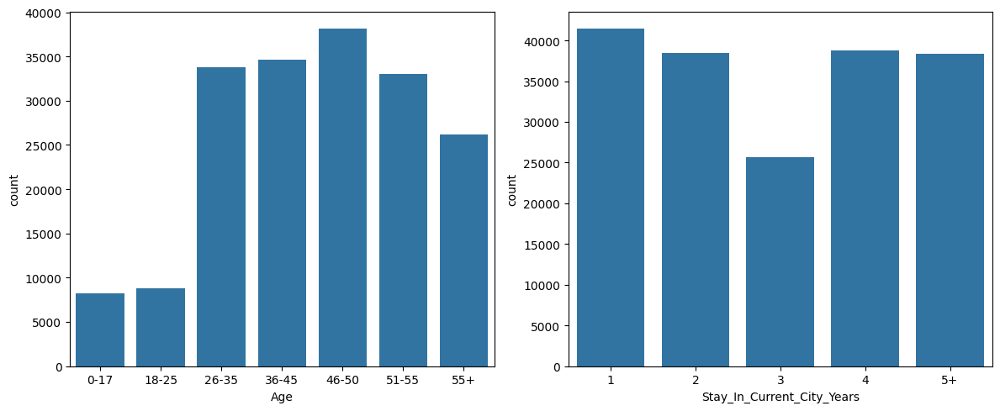

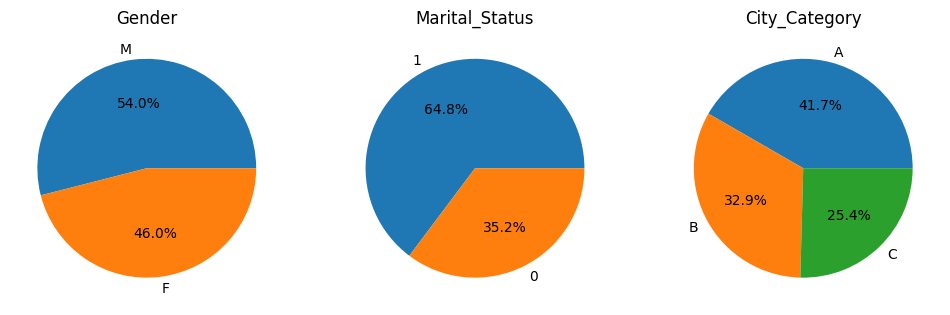

In [152]:
fig, axs = plt.subplots(1,2, figsize=(12,5))
sns.countplot(data=df, x='Age', order=['0-17', '18-25', '26-35', '36-45', '46-50', '51-55', '55+'], ax=axs[0])
sns.countplot(data=df, x='Stay_In_Current_City_Years', order=['1', '2', '3', '4', '5+'], ax=axs[1])
plt.tight_layout()
plt.show()

fig, axs = plt.subplots(1,3, figsize=(12,5))
for i, column in enumerate(['Gender', 'Marital_Status', 'City_Category']):
    value_counts = df[column].value_counts()
    axs[i].pie(value_counts, labels=value_counts.index, autopct='%1.1f%%')
    axs[i].set_title(column)
plt.show()

Veamos ahora la distribución por categoría y subcategoría de producto.<br>
Podemos ver que la categoría 3 está más representada que el resto, mientras que en general se tiene un promedio similar para todas las categorías.<br>
Luego en cuanto a las subcategorías, se mapeo los valores faltantes a 0, ya que equivalen a no tener subcategoría. Luego podem´. ver que ambas subcategorías están mayormente vacías. Para la subcategoría 1 se tienen varios valores intermedios no representados, mientras que para la subcategoría 2 se tienen no representados de 1 a 4.

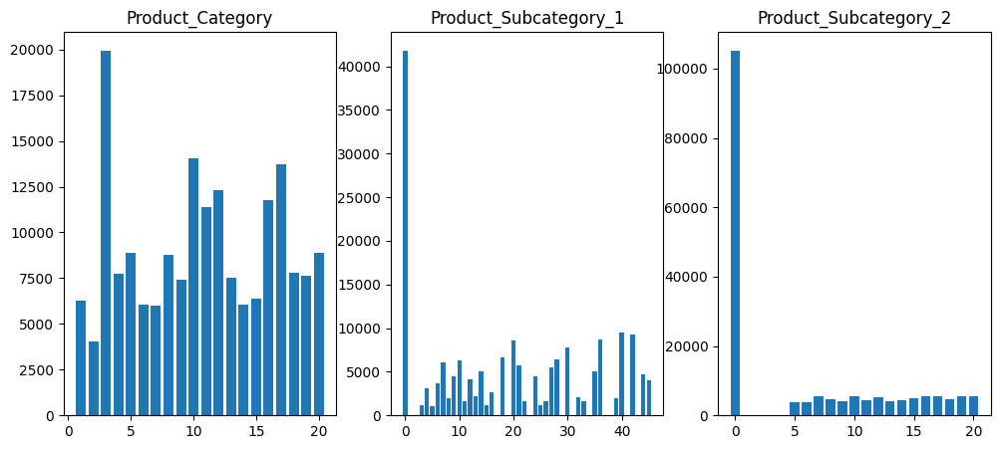

In [158]:
fig, axs = plt.subplots(1,3, figsize=(12,5))
for i, column in enumerate(['Product_Category', 'Product_Subcategory_1', 'Product_Subcategory_2' ]):
    value_counts = df[column].fillna(0).value_counts()
    labels_order = value_counts.index.sort_values()
    value_counts = value_counts.reindex(labels_order)
    axs[i].bar(x=value_counts.index, height=value_counts.values)
    axs[i].set_title(column)
plt.show()

Si vemos las distribuciones de edades, estado marital y categoría de ciudad discriminado por género, tenemos hallazgos interesantes:
- Las mujeres no están representadas en las edades 0-35 y los hombres no están representados a partir de 51.
- Las mujeres solteras no están representadas en el dataset.
- En la categoría de ciudad A no se tienen mujeres representadas, mientras que en la categoría C no se tienen hombres representados.

Esto puede hacer que el modelo quede sesgado y no logre generalizar bien si se expone a un input en una de las zonas no representadas.

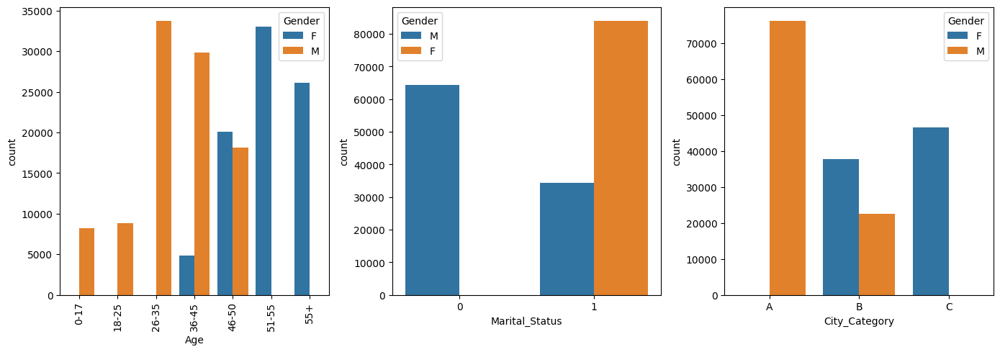

In [159]:
fig, axs = plt.subplots(1,3, figsize=(14,5))
sns.countplot(data=df, x='Age', hue='Gender',order=['0-17', '18-25', '26-35', '36-45', '46-50', '51-55', '55+'],ax=axs[0])
axs[0].tick_params(axis='x', rotation=90)
sns.countplot(data=df, x='Marital_Status', hue='Gender',ax=axs[1])
sns.countplot(data=df, x='City_Category', order=['A','B','C'], hue='Gender', ax=axs[2])
plt.tight_layout()
plt.show()

A continuación vemos box plots según:
- estado marital discriminado por edad.
- estado marital discriminado por género.
- género discriminado por categoría de ciudad.

Observamos que:
- los casados tienen percentiles superiores más altos de valor de compra.
- los casados a medida que avanzan en edad disminuyen su valor de compra promedio y el rango del mismo.
- los solteros de entre 26-35 son los que más gastan, mientras que los casados de 36-45 son lo que más gastan.
- los hombres casados gastan más que las mujeres casadas.
- los hombres gastan menos solteros que casados.
- tanto hombres como mujeres tienen una media e intervalo de gasto decreciente al bajar la categoría de la ciudad.

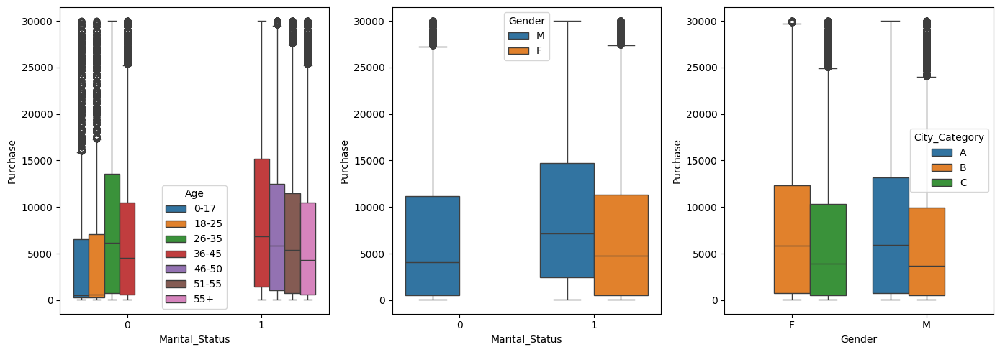

In [161]:
fig, axs = plt.subplots(1,3, figsize=(14,5))
sns.boxplot(data=df, y='Purchase', x='Marital_Status', hue='Age', hue_order=['0-17', '18-25', '26-35', '36-45', '46-50', '51-55', '55+'], ax=axs[0])
sns.boxplot(data=df, y='Purchase', x='Marital_Status', hue='Gender', ax=axs[1])
sns.boxplot(data=df, y='Purchase', x='Gender', hue='City_Category', ax=axs[2], hue_order=['A','B','C'])
plt.tight_layout()
plt.show()

Pasemos ahora al **preparado de los datos**:<br>
- Se descartan las columnas de `ID` ya que no nos son de utilidad al contener datos muy específicos del cliente y del producto.
- Debemos llenar los valores `NaN` que se tiene presentes en las categorias 'Product_Subcategory_1' y 'Product_Subcategory_2'. Utilizamos 0 como valor para representar que no se tiene una subcategoría.
- Debemos convertir `Age`, `Stay_In_Current_City_Years` y `City_Category` en variables numéricas ordinales que pueda entender nuestro modelo, ya que contiene información el orden en estas categorías. Para ello utilizamos un encoder ordinal de `sklearn`.
- Para el `Gender` utilizamos un one-hot encoder que nos de 0 o 1 según el caso.
- Queda como duda de si ayudará o no al modelo escalar la label `Purchase`, ya que los valores de la misma tienen mucha distancia. Este paso se deja para el análisis del modelo.

A continuación se tiene la preparación de los datos:

In [164]:
# filter features not useful
df = df.drop(labels=['User_ID','Product_ID'], axis=1)

# convert nan in Product Subcategories into 0
df[['Product_Subcategory_1', 'Product_Subcategory_2']] = df[['Product_Subcategory_1', 'Product_Subcategory_2']].fillna(value=0)

# encoding
df_encoded = df.copy()

# ordinal_encoder
for col, order in zip(
    ['City_Category', 'Age', 'Stay_In_Current_City_Years'],
    [['A', 'B', 'C'], ['0-17', '18-25', '26-35', '36-45', '46-50', '51-55', '55+'], ['1', '2', '3', '4', '5+']]):
    ordinal_encoder = sklearn.preprocessing.OrdinalEncoder(categories=[order])
    col_data = df_encoded[col].array.reshape(-1,1)
    col_data = ordinal_encoder.fit_transform(col_data)
    df_encoded[col] = col_data

# one-hot encoding
for col in ['Gender']:
    oh_encoder = sklearn.preprocessing.OneHotEncoder(drop='if_binary')
    col_data = df_encoded[col].array.reshape(-1,1)
    col_data = oh_encoder.fit_transform(col_data).toarray()
    df_encoded[col] = col_data

In [165]:
df_encoded

,Age,Gender,Marital_Status,City_Category,Stay_In_Current_City_Years,Product_Category,Product_Subcategory_1,Product_Subcategory_2,Purchase
0,4.0,0.0,1,1.0,0.0,10,45.0,0.0,1810
1,3.0,1.0,0,0.0,2.0,11,27.0,0.0,12351
2,3.0,1.0,1,0.0,4.0,4,28.0,0.0,127
3,3.0,1.0,1,0.0,0.0,16,9.0,8.0,2214
4,4.0,1.0,1,0.0,4.0,3,0.0,0.0,7142
...,...,...,...,...,...,...,...,...,...
182716,3.0,1.0,1,0.0,0.0,19,39.0,8.0,21830
182717,5.0,0.0,1,2.0,2.0,17,32.0,18.0,558
182718,4.0,0.0,1,1.0,3.0,4,0.0,16.0,308
182719,4.0,0.0,1,1.0,2.0,3,36.0,6.0,3401


In [8]:
# verifiquemos que no hayan quedado valores nulos
df_encoded.isna().sum()

Age                           0
Gender                        0
Marital_Status                0
City_Category                 0
Stay_In_Current_City_Years    0
Product_Category              0
Product_Subcategory_1         0
Product_Subcategory_2         0
Purchase                      0
dtype: int64

### 2b) Modelo Multilayer Perceptron (MLP) (2.5 puntos)
Entrenar un modelo de deep learning usando PyTorch que consuma el dataframe ya pre-procesado en el paso anterior.

Características para el diseño de la red:
- El modelo debe tener un mínimo de 3 capas ocultas.
- El modelo debe tener un mínimo de 32 neuronas por cada capa oculta.
- Cada capa oculta debe tener su respectiva función de activación.
- La elección de la función de activación de las capas ocultas es libre, pero se debe justificar por qué se está eligiendo esa, ya sea mediante conceptos teóricos o con resultados de pruebas empíricas.
- Analizar y justificar cuál es la mejor función de costo, algoritmo de optimización y learning rate para este modelo.
- Analizar cuál sería el mejor número de épocas para entrenar el modelo.
- Opcional: Incluir técnicas de regularización como dropout en las capas ocultas.

A continuación dejamos preparadas las funciones básicas que nos permitirán luego generar los modelos, entrenarlos y testearlos de forma más prolija.

In [175]:
from torch import nn
from torch.utils.data import TensorDataset, DataLoader
from sklearn.metrics import r2_score

def encode_df(df, scaling_label=False):
    df_encoded = df.copy()

    # ordinal_encoder
    for col, order in zip(
        ['City_Category', 'Age', 'Stay_In_Current_City_Years'],
        [['A', 'B', 'C'], ['0-17', '18-25', '26-35', '36-45', '46-50', '51-55', '55+'], ['1', '2', '3', '4', '5+']]):
        ordinal_encoder = sklearn.preprocessing.OrdinalEncoder(categories=[order])
        col_data = df_encoded[col].array.reshape(-1,1)
        col_data = ordinal_encoder.fit_transform(col_data)
        df_encoded[col] = col_data

    # one-hot encoding
    for col in ['Gender']:
        oh_encoder = sklearn.preprocessing.OneHotEncoder(drop='if_binary')
        col_data = df_encoded[col].array.reshape(-1,1)
        col_data = oh_encoder.fit_transform(col_data).toarray()
        df_encoded[col] = col_data
    
    # scaling
    if scaling_label:
        scaler = sklearn.preprocessing.StandardScaler()
        purchases = df_encoded['Purchase'].array.reshape(-1,1)
        scaled_purchases = scaler.fit_transform(purchases)
        df_encoded['Purchase'] = scaled_purchases
    
    return df_encoded, scaler if scaling_label else df_encoded

def make_X_y(df_encoded):
    X = torch.tensor(df_encoded.drop('Purchase', axis=1).values, dtype=torch.float32)
    y = torch.tensor(df_encoded[['Purchase']].values, dtype=torch.float32)
    X_train, X_test, y_train, y_test = sklearn.model_selection.train_test_split(X, y, test_size=0.3, random_state=17)
    # X_train_val, X_val, y_train_val, y_val = sklearn.model_selection.train_test_split(X_train, y_train, test_size=0.3, random_state=17)

    device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
    X_train, X_test, y_train, y_test = X_train.to(device), X_test.to(device), y_train.to(device), y_test.to(device)
    # X_train_val, X_val, y_train_val, y_val = X_train_val.to(device), X_val.to(device), y_train_val.to(device), y_val.to(device)

    return X_train, X_test, y_train, y_test, device

def train_model(model, epochs, loss, dl, opt, X_val, y_val, X_train='', y_train='', train_hist=False):
    loss_hist_test = []
    r2_hist_test = []
    loss_hist_train = []
    r2_hist_train = []
    if loss == 'RMSE' or loss == 'MSE':
        loss_fun = nn.MSELoss()
    elif loss == 'MAE':
        loss_fun = nn.L1Loss()

    # Evaluación de R^2 con la inicializacion
    model.eval()
    with torch.no_grad():
        yhat_test = model(X_val)
        y_true_np = y_val.view(-1).cpu().numpy()
        y_pred_np = yhat_test.view(-1).cpu().numpy()
        r2 = r2_score(y_true_np, y_pred_np)
        r2_hist_test.append(r2)

    print("Training model...")
    model.train()
    for epoch in range(epochs):
        epoch_loss = 0
        for xb, yb in dl:
            yhat = model(xb)
            if loss == 'RMSE':
                loss_val = torch.sqrt(loss_fun(yhat, yb))
            else:
                loss_val = loss_fun(yhat, yb)

            opt.zero_grad(set_to_none=True)
            loss_val.backward()
            opt.step()
            epoch_loss += loss_val.item()

        # Promedio de pérdidas por época de train
        if train_hist:
            epoch_loss /= len(dl)
            loss_hist_train.append(epoch_loss)

        # Evaluación de R2 por época
        model.eval()
        with torch.no_grad():
            # Calculo de R2 para entrenamiento
            if train_hist:
                yhat_train = model(X_train)
                y_true_np = y_train.view(-1).cpu().numpy()
                y_pred_np = yhat_train.view(-1).cpu().numpy()
                r2 = r2_score(y_true_np, y_pred_np)
                r2_hist_train.append(r2)

            # Calculo de R2 para test
            yhat_test = model(X_val)
            y_true_np = y_val.view(-1).cpu().numpy()
            y_pred_np = yhat_test.view(-1).cpu().numpy()
            r2 = r2_score(y_true_np, y_pred_np)
            r2_hist_test.append(r2)

            # Calculo de perdida para test
            if loss == 'RMSE':
                loss_val = torch.sqrt(loss_fun(yhat_test, y_val))
            else:
                loss_val = loss_fun(yhat_test, y_val)
            loss_hist_test.append(loss_val.item())

        model.train()
    print("Training finished!")

    if train_hist:
        return loss_hist_test, r2_hist_test, loss_hist_train, r2_hist_train
    else:
        return loss_hist_test, r2_hist_test

def test_model(model, loss, X_test, y_test):
    model.eval()
    if loss == 'RMSE' or loss == 'MSE':
        loss_fun = nn.MSELoss()
    elif loss == 'MAE':
        loss_fun = nn.L1Loss()
    with torch.no_grad():
        yhat = model(X_test)
        loss_val = loss_fun(yhat, y_test).item()
        if loss == 'RMSE':
            loss_val = loss_val ** 0.5
        y_true_np = y_test.view(-1).cpu().numpy()
        y_pred_np = yhat.view(-1).cpu().numpy()
        r2 = r2_score(y_true_np, y_pred_np)

    print(f"{loss}={loss_val:.4f}  R2={r2:.4f}")

#### Comparación de escalado de columna de target 'Purchase'
Como la columna target tiene valores muy distantes entre sí, esto podría traer problema numéricos al aplicar técnicas de optimización por gradiente. Se supone entonces a priori que un escaleo de los valores por medio de un `StandardScaler` de `scikit-learn` ayudaría fuertemente el aprendizaje del modelo.<br>
Se evalúa entonces un modelo de red neuronal con 3 capas oculta con 32 neuronas c/u y función de activación ReLU, con 3 learning rates: 1E-2, 1E-3, 5E-4 y 1E-4.<br>

Lo que se observa es:
- El modelo al cual se le pasa el label escalado tiene mejor performance, aprendiendo más rápido y logrando un $R^2$ más cercano a 1.
- El modelo con el label escalado no tiene buena performance con el learning rate 1E-2, siendo demasiado grande el mismo.
- El modelo con el label crudo ya para un learning rate de 1E-3 tiene un crecimiento demasiado lento y los 30 epochs asignados son insuficientes para lograr un $R^2$ satisfactorio.

A continuación se tiene una tabla comparativa:

|Modelo|learning rate|$R^2$|
|---            |:---:                                      |:---:                          |
|escalado       | $10^{-2}$ <br> $10^{-3}$ <br> $5\cdot 10^{-4}$ <br> $10^{-4}$   | $0.7370$ <br> $0.8208$ <br> $0.7613$ <br> $0.5012$ |
|no escalado    | $10^{-2}$ <br> $10^{-3}$ <br> $5\cdot 10^{-4}$ <br> $10^{-4}$   | $0.7860$ <br> $0.6281$ <br> $0.3360$ <br> $0.1221$  |

**Concluimos entonces que es mejor alternativa suministrar los datos de label escalados, y que el learning rate de 5E-4 es el que mejor relación rapidez-precisión obtiene, logrando una convergencia suave.**

Training model...
Training finished!
Adam mini-batch usando torch.nn  RMSE=0.5138  R2=0.7370  device=cpu
Training model...


KeyboardInterrupt: 

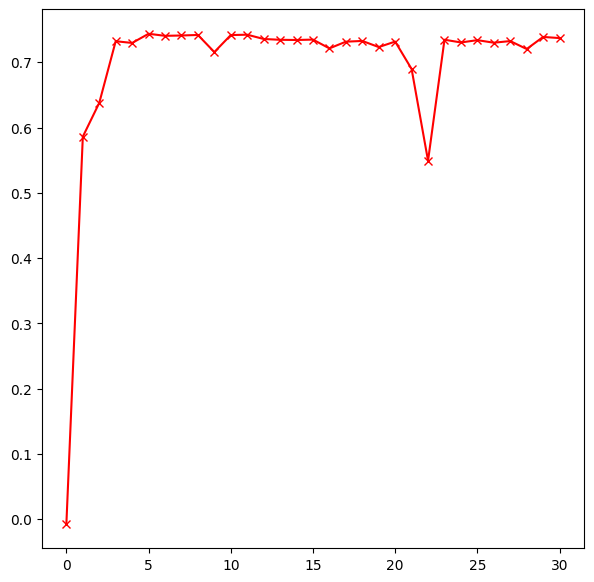

In [ ]:
# comparemos la performance con o sin escaleo del target
batch_size = 256
epochs = 30

colors = {
    1e-2: 'r', 
    1e-3: 'b', 
    5e-4: 'g',
    1e-4: 'purple',
}

fig, axs = plt.subplots(1,1, figsize=(7,7))

for scaling in [True, False]:
    if scaling:
        df_encoded, scaler = encode_df(df, scaling_label=scaling)
    else:
        df_encoded = encode_df(df, scaling_label=scaling)

    # dividir en entrenamiento y test
    X_train, X_test, y_train, y_test, device = make_X_y(df_encoded)
    features = X_train.shape[1]

    for lr in [1e-2, 1e-3, 5e-4, 1e-4]:
    # for lr in [1e-2, 1e-3]:
        torch.manual_seed(42) # misma seed para tener reproducibilidad de la inicializacion de los parametros de las capas
        model = nn.Sequential(
            nn.Linear(features,32),
            nn.ReLU(),
            nn.Linear(32,32),
            nn.ReLU(),
            nn.Linear(32,32),
            nn.ReLU(),
            nn.Linear(32,32),
            nn.ReLU(),
            nn.Linear(32,1)
        ).to(device)

        ds = TensorDataset(X_train, y_train)
        g = torch.Generator()
        g.manual_seed(17) # misma seed para tener reproducibilidad del DataLoador 
        dl = DataLoader(ds, batch_size=batch_size, shuffle=True, drop_last=False, generator=g)

        opt = torch.optim.Adam(model.parameters(), lr=lr)
        # mse_loss = nn.MSELoss()

        loss_hist, r2_hist = train_model(model, epochs, 'RMSE', dl, opt, X_val=X_test, y_val=y_test)
        test_model(model, 'RMSE', X_test, y_test)

        axs.plot(
            r2_hist, 
            label=f"Escalado - lr={lr}" if scaling else f"No escalado - lr={lr}",
            marker = 'x' if scaling else 'o',
            color = colors[lr]
        )
    
axs.set_xlabel('epochs')
axs.set_ylabel('R^2')
axs.grid()
axs.legend()

plt.tight_layout()
plt.show()

#### Comparativa de funciones de activación
A continuación realizamos una comparativa entre 5 funciones de activación:<br>
- `ReLU`
- `LeakyReLU`
- `GLU`
- `Softplus`
- `Tanh`

Las primeras 4 son del estilo "linear unit" (el cual es el tipo de función de activación más usado en problemas de regresión), mientras que la `tanh` se plantea como una alternativa diferente a pesar de no ser utilizada generalmente en problemas de regresión.

*Nota:* como la función `GLU` tiene la particularidad de recibir `N` valores y devolver `M=N/2` valores (ver [doc. `pytorch.nn.GLU`](https://docs.pytorch.org/docs/stable/generated/torch.nn.GLU.html#torch.nn.GLU)), si se aplicara la misma cantidad de neuronas que para el resto de funciones se tendría que optimizar menos parámetros. Es por esto que, para que la comparación sea justa para `GLU`, la hacemos a (casi) igual cantidad de parámetros a optimizar. Como los parámetros para cada capa lineal vienen dados por `(in * out) + out`, para 3 capas, con 32 neuronas en el resto de caso, la `GLU` da casi los mismos parámetros a 44 neuronas por capa.

Lo que se observa es:
- La `GLU` es la función de activación con mejor performance.
- Las funciones `LeakyReLU`, `ReLU` y `Tanh` se encuentran cerca de la `GLU` con performance decreciente respectivamente.
- Sorprende el buen performance de la `Tanh`. Esperaba que tuviera mayores problemas de convergencia.
- La `Softplus` muestra una convergencia más lenta.
- Ninguna función parecería no tener convergencia a valores razonable de $R^2$, aunque si la `GLU` converge a una asintota mayor que el resto.

Sequential(
  (input): Linear(in_features=8, out_features=32, bias=True)
  (ReLU_0): ReLU()
  (linear_0): Linear(in_features=32, out_features=32, bias=True)
  (ReLU_1): ReLU()
  (linear_1): Linear(in_features=32, out_features=32, bias=True)
  (ReLU_2): ReLU()
  (linear_2): Linear(in_features=32, out_features=32, bias=True)
  (ReLU_3): ReLU()
  (output): Linear(in_features=32, out_features=1, bias=True)
)
Total parameters to learn: 3489
Training model...
Training finished!
Adam mini-batch usando torch.nn  RMSE=0.4382  R2=0.8087  device=cpu
Sequential(
  (input): Linear(in_features=8, out_features=32, bias=True)
  (LeakyReLU_0): LeakyReLU(negative_slope=0.01)
  (linear_0): Linear(in_features=32, out_features=32, bias=True)
  (LeakyReLU_1): LeakyReLU(negative_slope=0.01)
  (linear_1): Linear(in_features=32, out_features=32, bias=True)
  (LeakyReLU_2): LeakyReLU(negative_slope=0.01)
  (linear_2): Linear(in_features=32, out_features=32, bias=True)
  (LeakyReLU_3): LeakyReLU(negative_slope=0

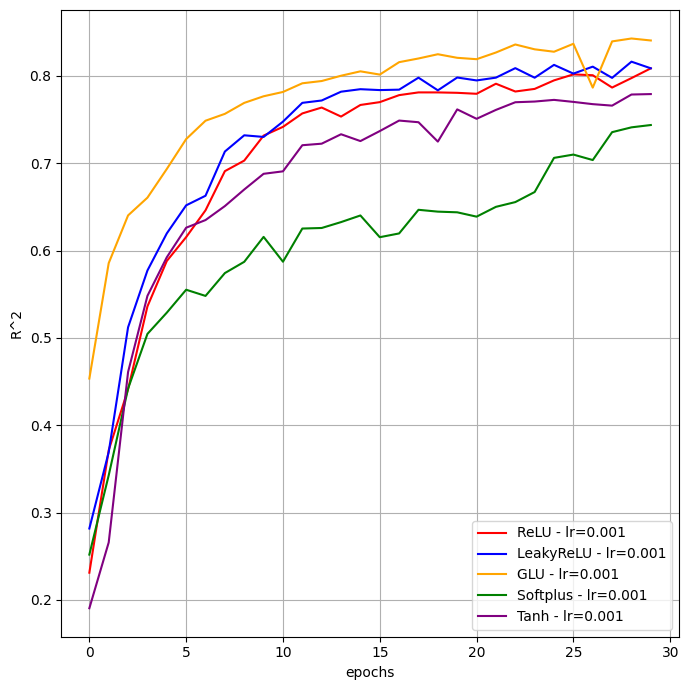

In [ ]:
from collections import OrderedDict
# comparemos la performance de distintas funciones de activación
batch_size = 256
epochs = 30
lr = 5e-4

colors = {
    "ReLU"      : 'r', 
    "LeakyReLU" : 'b', 
    "GLU"       : 'orange', 
    "Softplus"  : 'g',
    "Tanh"      : 'purple'
}
funcs = {
    "ReLU"      : nn.ReLU(),
    "LeakyReLU" : nn.LeakyReLU(),
    "GLU"       : nn.GLU(),
    "Softplus"  : nn.Softplus(),
    "Tanh"      : nn.Tanh()
}

fig, axs = plt.subplots(1,1, figsize=(7,7))

df_encoded, scaler = encode_df(df, scaling_label=True)
# dividir en entrenamiento y test
X_train, X_test, y_train, y_test, device = make_X_y(df_encoded)
features = X_train.shape[1]


for act_fun in ["ReLU", "LeakyReLU", "GLU", "Softplus", "Tanh"]:
# for act_fun in ["GLU", "Softplus", "Tanh"]:
# for act_fun in ["GLU"]:
    neurons = 32 if act_fun != "GLU" else 44
    model_order = [
        ("input", nn.Linear(features, neurons))
    ]
    for i in range(3):
        model_order.append((f"{act_fun}_{i}", funcs[act_fun]))
        model_order.append((
            f"linear_{i}", 
            nn.Linear(
                neurons if act_fun != "GLU" else neurons // 2,
                neurons
            )
        ))
    model_order.append((f"{act_fun}_{i+1}", funcs[act_fun]))

    model_order.append((
        f"output", 
        nn.Linear(
            neurons if act_fun != "GLU" else neurons // 2,
            1
        )
    ))

    torch.manual_seed(42)
    model = nn.Sequential(OrderedDict(model_order)).to(device)
    print(model)
    total_params = sum(p.numel() for p in model.parameters())
    print(f"Total parameters to learn: {total_params}")
    ds = TensorDataset(X_train, y_train)
    g = torch.Generator()
    g.manual_seed(17)
    dl = DataLoader(ds, batch_size=batch_size, shuffle=True, drop_last=False, generator=g)

    opt = torch.optim.Adam(model.parameters(), lr=lr)
    # mse_loss = nn.MSELoss()

    loss_hist, r2_hist = train_model(model, epochs, 'RMSE', dl, opt, X_val=X_test, y_val=y_test)
    test_model(model, 'RMSE', X_test, y_test)

    axs.plot(
        r2_hist, 
        label=f"{act_fun} - lr={lr}",
        color = colors[act_fun]
    )
    
axs.set_xlabel('epochs')
axs.set_ylabel('R^2')
axs.grid()
axs.legend()

plt.tight_layout()
plt.show()

#### Prueba de combinación de funciones de activación <a name="combinacion-fact"></a>
Para evaluar si podemos sacar provecho de combinar distintas funciones de activación, probamos hacer una mezcla de las 2 mejores funciones de activación del estudio anterior (`GLU` y `LeakyReLU`) contra una red con todas las funciones de activación `GLU`.<br>
Analizando el gráfico a continuación, se observa que no se obtiene ninguna ganancia, y mantener la red sólo con `GLU` como tipo de función de activación es lo mejor.

Sequential(
  (input): Linear(in_features=8, out_features=44, bias=True)
  (GLU_0): GLU(dim=-1)
  (linear_0): Linear(in_features=22, out_features=44, bias=True)
  (GLU_1): GLU(dim=-1)
  (linear_1): Linear(in_features=22, out_features=44, bias=True)
  (GLU_2): GLU(dim=-1)
  (linear_2): Linear(in_features=22, out_features=44, bias=True)
  (output): Linear(in_features=44, out_features=1, bias=True)
)
Total parameters to learn: 3477
Training model...


KeyboardInterrupt: 

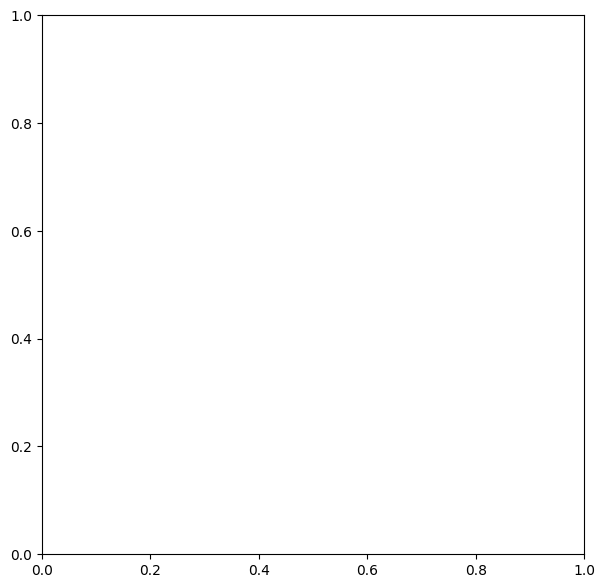

In [ ]:
# comparemos la performance de combinar distintas funciones de activación
batch_size = 256
epochs = 30
lr = 5e-4

funcs = {
    "LeakyReLU" : nn.LeakyReLU(),
    "GLU"       : nn.GLU(),
}

fig, axs = plt.subplots(1,1, figsize=(7,7))

df_encoded, scaler = encode_df(df, scaling_label=True)
# dividir en entrenamiento y test
X_train, X_test, y_train, y_test, device = make_X_y(df_encoded)
features = X_train.shape[1]

combinations = [['GLU','GLU','GLU','GLU'],['GLU','LeakyReLU','GLU','LeakyReLU'],['LeakyReLU','GLU','LeakyReLU','GLU']]
neurons_amount = [44, 38, 34]
for combination, neurons in zip(combinations, neurons_amount):
    torch.manual_seed(42)
    model_order = [
        ("input", nn.Linear(features, neurons))
    ]
    for i in range(3):
        model_order.append((f"{combination[i]}_{i}", funcs[combination[i]]))
        model_order.append((
            f"linear_{i}", 
            nn.Linear(
                neurons if combination[i] != "GLU" else neurons // 2,
                neurons
            )
        ))
    model_order.append((f"{combination[-1]}_{i}", funcs[combination[-1]]))

    model_order.append((
            f"output",
            nn.Linear(
                neurons // 2  if (combination[-1] == "GLU" and combination[-2] == "LeakyReLU") else neurons,
                1 
            )
    ))

    model = nn.Sequential(OrderedDict(model_order)).to(device)
    print(model)
    total_params = sum(p.numel() for p in model.parameters())
    print(f"Total parameters to learn: {total_params}")
    ds = TensorDataset(X_train, y_train)
    g = torch.Generator()
    g.manual_seed(17)
    dl = DataLoader(ds, batch_size=batch_size, shuffle=True, drop_last=False, generator=g)

    opt = torch.optim.Adam(model.parameters(), lr=lr)
    # mse_loss = nn.MSELoss()

    loss_hist, r2_hist = train_model(model, epochs, 'RMSE', dl, opt, X_val=X_test, y_val=y_test)
    test_model(model, 'RMSE', X_test, y_test)

    axs.plot(
        r2_hist, 
        label=f"{combination} - lr={lr}",
        # color = colors[act_fun]
    )
    
axs.set_xlabel('epochs')
axs.set_ylabel('R^2')
axs.grid()
axs.legend()

plt.tight_layout()
plt.show()

#### Prueba de cantidad de capas
A continuación vamos a probar si agregar más capas a nuestra red neuronal nos permite una mejora en la precisión del modelo. Se prueba entre 3 y 6 capas.<br>

Lo que se observa a continuación es que el aumentar la cantidad de capas no incurre en una mejora del modelo. Por lo tanto se concluye utilizar 3 capas neuronales.

Sequential(
  (input): Linear(in_features=8, out_features=32, bias=True)
  (GLU_0): GLU(dim=-1)
  (linear_0): Linear(in_features=16, out_features=32, bias=True)
  (GLU_1): GLU(dim=-1)
  (linear_1): Linear(in_features=16, out_features=32, bias=True)
  (GLU_2): GLU(dim=-1)
  (linear_2): Linear(in_features=16, out_features=32, bias=True)
  (GLU_3): GLU(dim=-1)
  (output): Linear(in_features=16, out_features=1, bias=True)
)
Total parameters to learn: 1937
Training model...
Training finished!
Adam mini-batch usando torch.nn  RMSE=0.4091  R2=0.8332  device=cpu
Sequential(
  (input): Linear(in_features=8, out_features=32, bias=True)
  (GLU_0): GLU(dim=-1)
  (linear_0): Linear(in_features=16, out_features=32, bias=True)
  (GLU_1): GLU(dim=-1)
  (linear_1): Linear(in_features=16, out_features=32, bias=True)
  (GLU_2): GLU(dim=-1)
  (linear_2): Linear(in_features=16, out_features=32, bias=True)
  (GLU_3): GLU(dim=-1)
  (linear_3): Linear(in_features=16, out_features=32, bias=True)
  (GLU_4): GLU

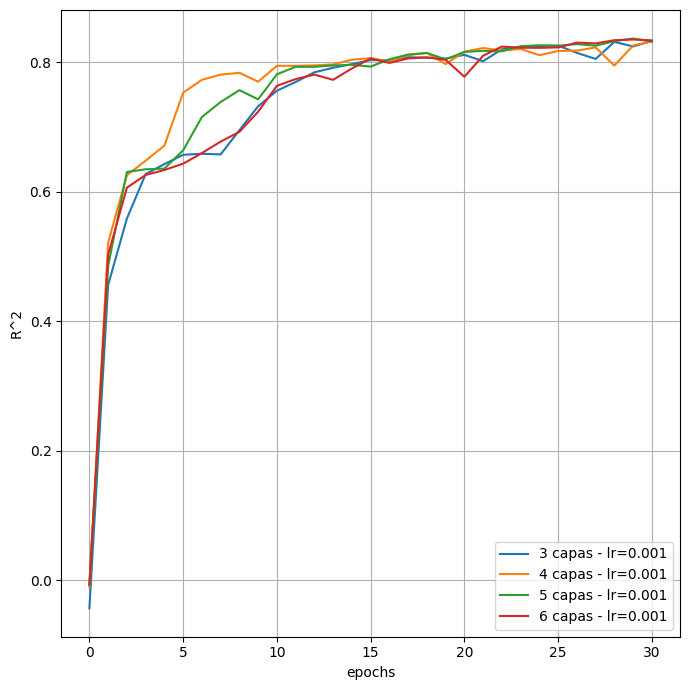

In [ ]:
# comparemos la performance según cantidad de capas 
batch_size = 256
epochs = 30
lr = 5e-4

fig, axs = plt.subplots(1,1, figsize=(7,7))

df_encoded, scaler = encode_df(df, scaling_label=True)
# dividir en entrenamiento y test
X_train, X_test, y_train, y_test, device = make_X_y(df_encoded)
features = X_train.shape[1]


for capas in range(3,7):
    torch.manual_seed(42)
    neurons = 32
    model_order = [
        ("input", nn.Linear(features, neurons))
    ]
    for i in range(capas):
        model_order.append((f"GLU_{i}", nn.GLU()))
        model_order.append((
            f"linear_{i}", 
            nn.Linear(
                neurons // 2,
                neurons
            )
        ))
    model_order.append((f"GLU_{i+1}", nn.GLU()))

    model_order.append((f"output", nn.Linear(neurons//2, 1)))

    model = nn.Sequential(OrderedDict(model_order)).to(device)
    print(model)
    total_params = sum(p.numel() for p in model.parameters())
    print(f"Total parameters to learn: {total_params}")
    ds = TensorDataset(X_train, y_train)
    g = torch.Generator()
    g.manual_seed(17)
    dl = DataLoader(ds, batch_size=batch_size, shuffle=True, drop_last=False, generator=g)

    opt = torch.optim.Adam(model.parameters(), lr=lr)
    # mse_loss = nn.MSELoss()

    loss_hist, r2_hist = train_model(model, epochs, 'RMSE', dl, opt, X_val=X_test, y_val=y_test)
    test_model(model, 'RMSE', X_test, y_test)

    axs.plot(
        r2_hist, 
        label=f"{capas} capas - lr={lr}",
        # color = colors[act_fun]
    )
    
axs.set_xlabel('epochs')
axs.set_ylabel('R^2')
axs.grid()
axs.legend()

plt.tight_layout()
plt.show()

#### Prueba de cantidad de neuronas por capa
A continuación se prueba aumentar la cantidad de neuronas por capa, desde 32 hasta 88 en pasos de a 8 neuronas.<br>
Podemos observar en la gráfica de $R^2$ que de 48 a 88 neuronas se tiene un resultado final muy similar. Luego si vemos en detalle el gráfico de $R^2$ contra cantidad de neuronas por capa, podemos ver que para 64 neuronas ya no se tiene una ganancia tan importante. Además en el gráfico de tiempo de entrenamiento contra cantida de neuronas, podemos ver que es provechoso aumentar la cantidad de neuronas de 32 a 48 para obtener un menor tiempo de cómputo. Esto sospecho que se debe a que a menores neuronas por capa se debe realizar mayor cantidad de iteraciones en el algorítmo de optimización y esto luego incurre en que se tarde más. Luego de las 48 neuronas por capa no se tiene beneficio en tiempo de entrenamiento, siendo este casi constante.<br>
Se concluye entonces que un buen balance entre precisión y tiempo de cómputo es utilizar 64 neuronas por capa.

Sequential(
  (input): Linear(in_features=8, out_features=32, bias=True)
  (GLU_0): GLU(dim=-1)
  (linear_0): Linear(in_features=16, out_features=32, bias=True)
  (GLU_1): GLU(dim=-1)
  (linear_1): Linear(in_features=16, out_features=32, bias=True)
  (GLU_2): GLU(dim=-1)
  (linear_2): Linear(in_features=16, out_features=32, bias=True)
  (GLU_3): GLU(dim=-1)
  (output): Linear(in_features=16, out_features=1, bias=True)
)
Total parameters to learn: 1937
Training model...
Training finished!
Adam mini-batch usando torch.nn  RMSE=0.4228  R2=0.8219  device=cpu
Sequential(
  (input): Linear(in_features=8, out_features=40, bias=True)
  (GLU_0): GLU(dim=-1)
  (linear_0): Linear(in_features=20, out_features=40, bias=True)
  (GLU_1): GLU(dim=-1)
  (linear_1): Linear(in_features=20, out_features=40, bias=True)
  (GLU_2): GLU(dim=-1)
  (linear_2): Linear(in_features=20, out_features=40, bias=True)
  (GLU_3): GLU(dim=-1)
  (output): Linear(in_features=20, out_features=1, bias=True)
)
Total parameter

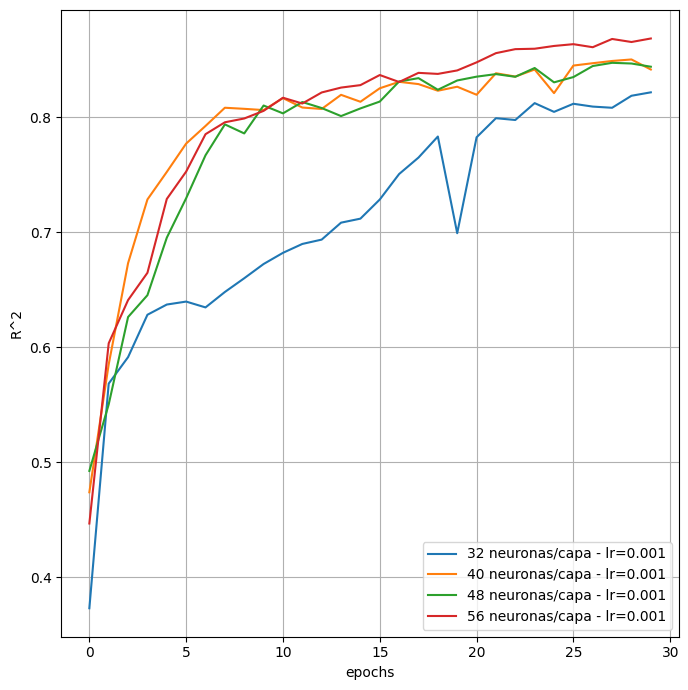

In [ ]:
# comparemos la performance según cantidad de neuronas 
import time
batch_size = 256
epochs = 30
lr = 5e-4

fig, axs = plt.subplots(1,1, figsize=(7,7))

df_encoded, scaler = encode_df(df, scaling_label=True)
# dividir en entrenamiento y test
X_train, X_test, y_train, y_test, device = make_X_y(df_encoded)
features = X_train.shape[1]

r2_evol = []
training_times = []

for neurons_mult in range(8):
    neurons = 32 + 8 * neurons_mult
    torch.manual_seed(42)
    model_order = [
        ("input", nn.Linear(features, neurons))
    ]
    for i in range(3):
        model_order.append((f"GLU_{i}", nn.GLU()))
        model_order.append((
            f"linear_{i}", 
            nn.Linear(
                neurons // 2,
                neurons
            )
        ))
    model_order.append((f"GLU_{i+1}", nn.GLU()))

    model_order.append((f"output", nn.Linear(neurons // 2, 1)))

    model = nn.Sequential(OrderedDict(model_order)).to(device)
    print(model)
    total_params = sum(p.numel() for p in model.parameters())
    print(f"Total parameters to learn: {total_params}")
    ds = TensorDataset(X_train, y_train)
    g = torch.Generator()
    g.manual_seed(17)
    dl = DataLoader(ds, batch_size=batch_size, shuffle=True, drop_last=False, generator=g)

    opt = torch.optim.Adam(model.parameters(), lr=lr)
    # mse_loss = nn.MSELoss()

    start_time = time.perf_counter()
    loss_hist, r2_hist = train_model(model, epochs, 'RMSE', dl, opt, X_val=X_test, y_val=y_test)
    end_time = time.perf_counter()
    training_times.append(end_time - start_time)
    test_model(model, 'RMSE', X_test, y_test)

    axs.plot(
        r2_hist, 
        label=f"{neurons} neuronas/capa - lr={lr}",
        # color = colors[act_fun]
    )

    r2_evol.append(r2_hist[-1])
    
axs.set_xlabel('epochs')
axs.set_ylabel('R^2')
axs.grid()
axs.legend()

plt.tight_layout()
plt.show()

ValueError: x and y must have same first dimension, but have shapes (8,) and (6,)

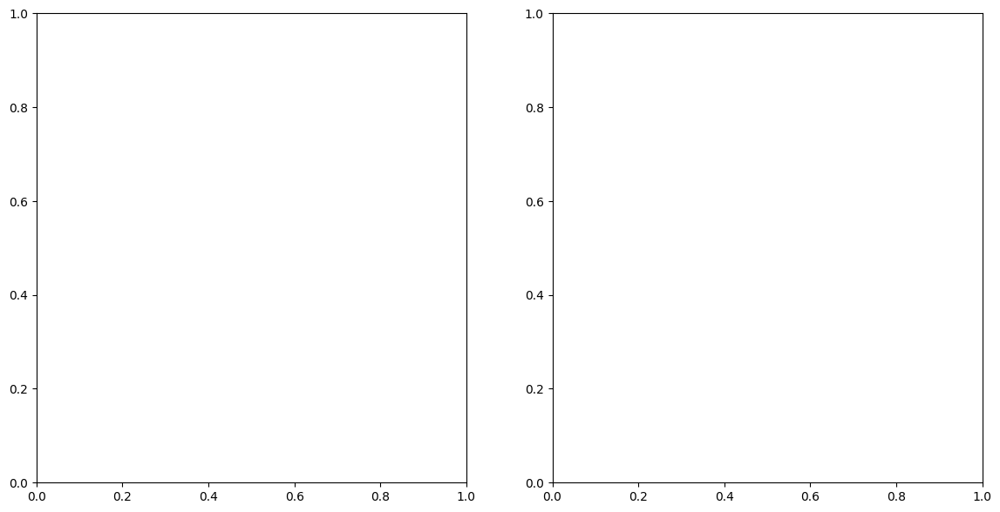

In [167]:
fig, axs = plt.subplots(1,2,figsize=(14,7))
neuronas = [32 + 8*i for i in range(8)]
axs[0].plot(neuronas, r2_evol, marker='.')
axs[0].set_ylabel('R^2')
axs[0].set_xlabel('neuronas')
axs[1].plot(neuronas, training_times, marker='.')
axs[1].set_ylabel('tiempo de entrenamiento [s]')
axs[1].set_xlabel('neuronas')

#### Análisis de tamaño de batch size
Analizaremos ahora el tamaño de batch, tomando valores entre 100 y 700.<br>
Lo que observamos es a que a menores batch sizes se tiene mayor tiempo de entrenamiento, lo cual es esperable al tener que realizar más "pasadas" por epoch.<br>
Luego tenemos que el valor final de $R^2$ aumenta al tener menor batch size, por lo que se debe elegir un punto intermedio para equilibrar precisión y tiempo de cómputo. <br>
Se decide utilizar un batch size de 300 al estar en un punto intermedio de precisión y tiempo.


Sequential(
  (input): Linear(in_features=8, out_features=64, bias=True)
  (GLU_0): GLU(dim=-1)
  (linear_0): Linear(in_features=32, out_features=64, bias=True)
  (GLU_1): GLU(dim=-1)
  (linear_1): Linear(in_features=32, out_features=64, bias=True)
  (GLU_2): GLU(dim=-1)
  (linear_2): Linear(in_features=32, out_features=64, bias=True)
  (GLU_3): GLU(dim=-1)
  (output): Linear(in_features=32, out_features=1, bias=True)
)
Total parameters to learn: 6945
Training model...
Training finished!
Adam mini-batch usando torch.nn  RMSE=0.3675  R2=0.8654  device=cpu
Sequential(
  (input): Linear(in_features=8, out_features=64, bias=True)
  (GLU_0): GLU(dim=-1)
  (linear_0): Linear(in_features=32, out_features=64, bias=True)
  (GLU_1): GLU(dim=-1)
  (linear_1): Linear(in_features=32, out_features=64, bias=True)
  (GLU_2): GLU(dim=-1)
  (linear_2): Linear(in_features=32, out_features=64, bias=True)
  (GLU_3): GLU(dim=-1)
  (output): Linear(in_features=32, out_features=1, bias=True)
)
Total parameter

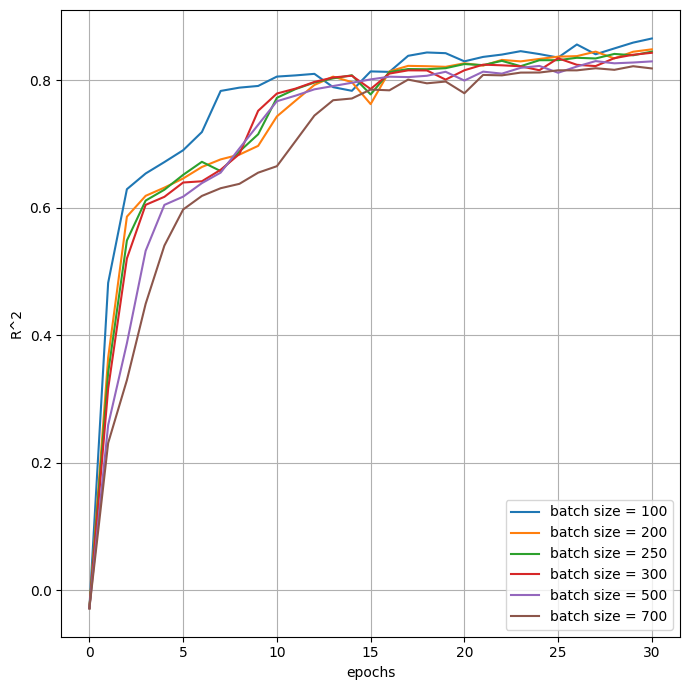

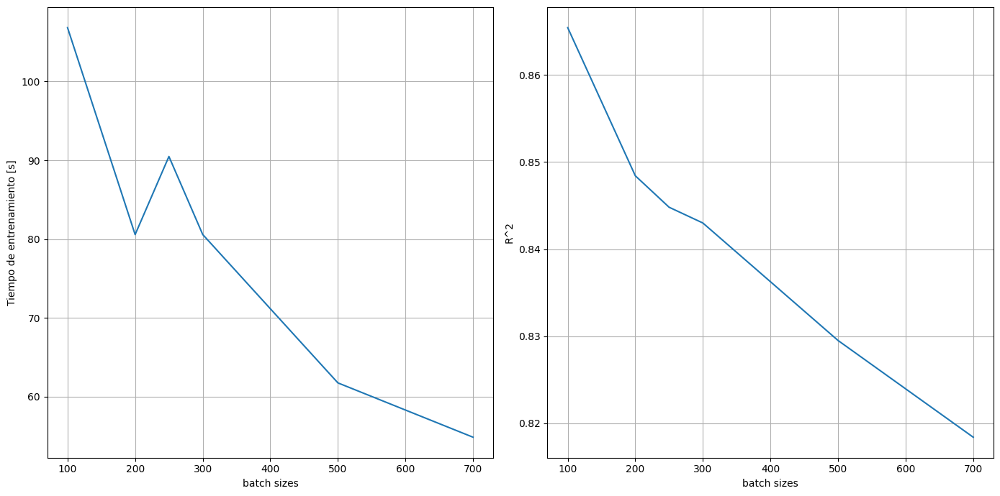

In [ ]:
# comparemos la performance según batch size 
import time

fig, axs = plt.subplots(1,1, figsize=(7,7))

df_encoded, scaler = encode_df(df, scaling_label=True)
# dividir en entrenamiento y test
X_train, X_test, y_train, y_test, device = make_X_y(df_encoded)
features = X_train.shape[1]

r2_evol = []
training_times = []

neurons = 64
lr = 5e-4
epochs = 30

batch_sizes = [100, 200, 250, 300, 500, 700]

for batch_size in batch_sizes:
    torch.manual_seed(42)
    model_order = [
        ("input", nn.Linear(features, neurons))
    ]
    for i in range(3):
        model_order.append((f"GLU_{i}", nn.GLU()))
        model_order.append((
            f"linear_{i}", 
            nn.Linear(
                neurons // 2,
                neurons
            )
        ))
    model_order.append((f"GLU_{i+1}", nn.GLU()))

    model_order.append((f"output", nn.Linear(neurons // 2, 1)))


    model = nn.Sequential(OrderedDict(model_order)).to(device)
    print(model)
    total_params = sum(p.numel() for p in model.parameters())
    print(f"Total parameters to learn: {total_params}")
    ds = TensorDataset(X_train, y_train)
    g = torch.Generator()
    g.manual_seed(17)
    dl = DataLoader(ds, batch_size=batch_size, shuffle=True, drop_last=False, generator=g)

    opt = torch.optim.Adam(model.parameters(), lr=lr)
    # mse_loss = nn.MSELoss()

    start_time = time.perf_counter()
    loss_hist, r2_hist = train_model(model, epochs, 'RMSE', dl, opt, X_val=X_test, y_val=y_test)
    end_time = time.perf_counter()
    training_times.append(end_time - start_time)
    test_model(model, 'RMSE', X_test, y_test)

    axs.plot(
        r2_hist, 
        label=f"batch size = {batch_size}",
    )

    r2_evol.append(r2_hist[-1])
    
axs.set_xlabel('epochs')
axs.set_ylabel('R^2')
axs.grid()
axs.legend()
plt.tight_layout()
plt.show()

fig, axs = plt.subplots(1,2, figsize=(14,7))
axs[0].plot(batch_sizes, training_times)
axs[0].set_xlabel('batch sizes')
axs[0].set_ylabel('Tiempo de entrenamiento [s]')
axs[0].grid()
axs[1].plot(batch_sizes, r2_evol)
axs[1].set_xlabel('batch sizes')
axs[1].set_ylabel('R^2')
axs[1].grid()
plt.tight_layout()
plt.show()


#### Análisis de cantidad de epochs
Por último queda analizar hasta cuando dejar entrenar al modelo, definiendo cuantos epochs de entrenamiento a realizar. Dejamos al modelo entrenar hasta 400 epochs y evaluamos su performance.<br>
Se observa que el modelo sigue mejorando hasta las 400 epochs, pero su mejora se ralentiza fuertemente a partir de las 100-150 epochs. Por lo tanto se concluye que el límite del modelo será de 150 epochs de entrenamiento.

Sequential(
  (input): Linear(in_features=8, out_features=64, bias=True)
  (GLU_0): GLU(dim=-1)
  (linear_0): Linear(in_features=32, out_features=64, bias=True)
  (GLU_1): GLU(dim=-1)
  (linear_1): Linear(in_features=32, out_features=64, bias=True)
  (GLU_2): GLU(dim=-1)
  (linear_2): Linear(in_features=32, out_features=64, bias=True)
  (GLU_3): GLU(dim=-1)
  (output): Linear(in_features=32, out_features=1, bias=True)
)
Total parameters to learn: 6945
Training model...
Training finished!
Adam mini-batch usando torch.nn  RMSE=0.3007  R2=0.9099  device=cpu


/tmp/ipykernel_6240/1854875084.py:63: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  axs.legend()


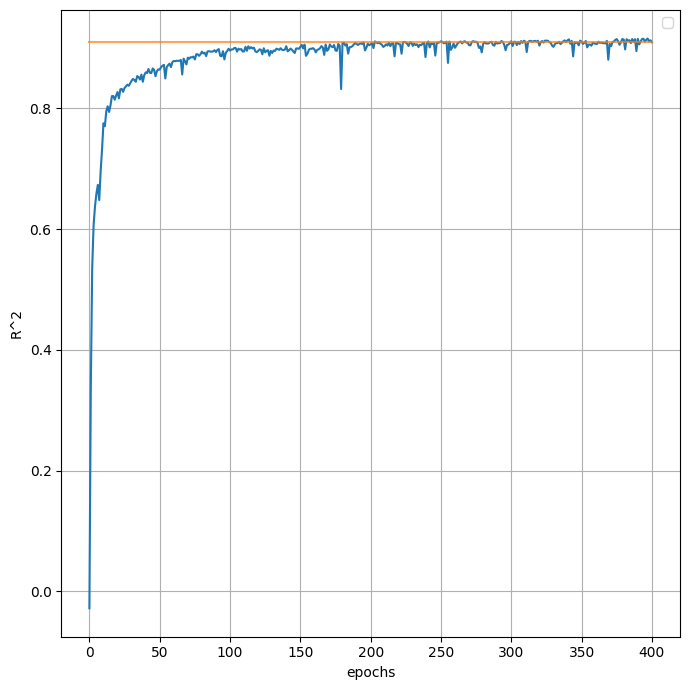

In [ ]:
# análisis de cantidad de epochs
batch_size = 256
epochs = 400
neurons = 64 
capas = 3
lr = 5e-4

fig, axs = plt.subplots(1,1, figsize=(7,7))

df_encoded, scaler = encode_df(df, scaling_label=True)
# dividir en entrenamiento y test
X_train, X_test, y_train, y_test, device = make_X_y(df_encoded)
features = X_train.shape[1]


torch.manual_seed(42)
model_order = [
    ("input", nn.Linear(features, neurons))
]
for i in range(3):
    model_order.append((f"GLU_{i}", nn.GLU()))
    model_order.append((
        f"linear_{i}", 
        nn.Linear(
            neurons // 2,
            neurons
        )
    ))
model_order.append((f"GLU_{i+1}", nn.GLU()))

model_order.append((f"output", nn.Linear(neurons//2, 1)))

model = nn.Sequential(OrderedDict(model_order)).to(device)
print(model)
total_params = sum(p.numel() for p in model.parameters())
print(f"Total parameters to learn: {total_params}")
ds = TensorDataset(X_train, y_train)
g = torch.Generator()
g.manual_seed(17)
dl = DataLoader(ds, batch_size=batch_size, shuffle=True, drop_last=False, generator=g)

opt = torch.optim.Adam(model.parameters(), lr=lr)
# mse_loss = nn.MSELoss()

loss_hist, r2_hist = train_model(model, epochs, 'RMSE', dl, opt, X_val=X_test, y_val=y_test)
test_model(model, 'RMSE', X_test, y_test)

axs.plot(
    r2_hist, 
    # label=f"{capas} capas - lr={lr}",
    # color = colors[act_fun]
)
axs.plot([0,epochs],[r2_hist[-1],r2_hist[-1]],alpha=0.7)
    
axs.set_xlabel('epochs')
axs.set_ylabel('R^2')
axs.grid()
axs.legend()

plt.tight_layout()
plt.show()

#### Análisis de la función de costo
A continuación evaluamos brevemente si se puede mejorar el comportamiento del modelo utilizando una función de costo diferente. Al tratarse de un problema de regresión utilizaremos, además del `RMSE` que venimos utilizando hasta ahora, `MAE` y `MSE`.

Se observa que el `RMSE` y `MSE` tiene performance similar, mientras que `MAE` tiene una performance un poco inferior. De igual manera tampoco se tienen diferencias abrumadoras.<br>
Se continua utilizanod `RMSE` ya que ninguna de las otras alternativas presentan una mejora.

Sequential(
  (input): Linear(in_features=8, out_features=64, bias=True)
  (GLU_0): GLU(dim=-1)
  (linear_0): Linear(in_features=32, out_features=64, bias=True)
  (GLU_1): GLU(dim=-1)
  (linear_1): Linear(in_features=32, out_features=64, bias=True)
  (GLU_2): GLU(dim=-1)
  (linear_2): Linear(in_features=32, out_features=64, bias=True)
  (GLU_3): GLU(dim=-1)
  (output): Linear(in_features=32, out_features=1, bias=True)
)
Total parameters to learn: 6945
Training model...
Training finished!
RMSE=0.3931  R2=0.8461
Sequential(
  (input): Linear(in_features=8, out_features=64, bias=True)
  (GLU_0): GLU(dim=-1)
  (linear_0): Linear(in_features=32, out_features=64, bias=True)
  (GLU_1): GLU(dim=-1)
  (linear_1): Linear(in_features=32, out_features=64, bias=True)
  (GLU_2): GLU(dim=-1)
  (linear_2): Linear(in_features=32, out_features=64, bias=True)
  (GLU_3): GLU(dim=-1)
  (output): Linear(in_features=32, out_features=1, bias=True)
)
Total parameters to learn: 6945
Training model...
Training f

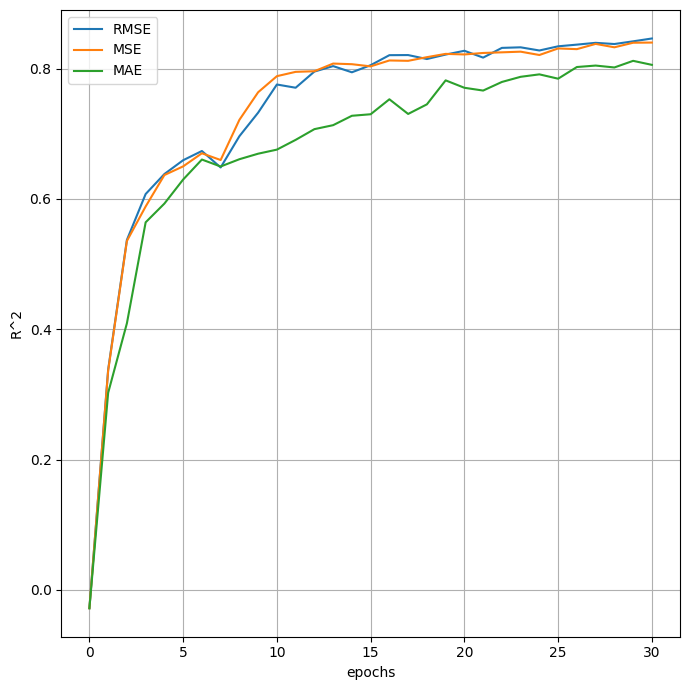

In [172]:
# análisis de función de costo 
batch_size = 256
epochs = 30
neurons = 64 
capas = 3
lr = 5e-4

fig, axs = plt.subplots(1,1, figsize=(7,7))

df_encoded, scaler = encode_df(df, scaling_label=True)
# dividir en entrenamiento y test
X_train, X_test, y_train, y_test, device = make_X_y(df_encoded)
features = X_train.shape[1]


for loss_func in ['RMSE', 'MSE', 'MAE']:
    torch.manual_seed(42)
    model_order = [
        ("input", nn.Linear(features, neurons))
    ]
    for i in range(3):
        model_order.append((f"GLU_{i}", nn.GLU()))
        model_order.append((
            f"linear_{i}", 
            nn.Linear(
                neurons // 2,
                neurons
            )
        ))
    model_order.append((f"GLU_{i+1}", nn.GLU()))

    model_order.append((f"output", nn.Linear(neurons//2, 1)))

    model = nn.Sequential(OrderedDict(model_order)).to(device)
    print(model)
    total_params = sum(p.numel() for p in model.parameters())
    print(f"Total parameters to learn: {total_params}")
    ds = TensorDataset(X_train, y_train)
    g = torch.Generator()
    g.manual_seed(17)
    dl = DataLoader(ds, batch_size=batch_size, shuffle=True, drop_last=False, generator=g)

    opt = torch.optim.Adam(model.parameters(), lr=lr)
    # mse_loss = nn.MSELoss()

    loss_hist, r2_hist = train_model(model, epochs, loss_func, dl, opt, X_val=X_test, y_val=y_test)
    test_model(model=model, loss=loss_func, X_test=X_test, y_test=y_test)

    axs.plot(
        r2_hist, 
        label=f"{loss_func}",
        # color = colors[act_fun]
    )
    
axs.set_xlabel('epochs')
axs.set_ylabel('R^2')
axs.grid()
axs.legend()

plt.tight_layout()
plt.show()

#### Análisis del algorítmo de optimización
A continuación se analiza probar stochastic gradient descent como el algorítmo de optimización.

Lo que se obtiene es que Adam es bastante más rápido convergiendo a igual learning rate. Podría ser el caso que gradient descent tenga mejor performance con un learning rate menor, por lo que en el siguiente bloque de código se analiza esta opción, llegando a la conclusión de que no es el caso y Adam logra una mejor convergencia.

Sequential(
  (input): Linear(in_features=8, out_features=64, bias=True)
  (GLU_0): GLU(dim=-1)
  (linear_0): Linear(in_features=32, out_features=64, bias=True)
  (GLU_1): GLU(dim=-1)
  (linear_1): Linear(in_features=32, out_features=64, bias=True)
  (GLU_2): GLU(dim=-1)
  (linear_2): Linear(in_features=32, out_features=64, bias=True)
  (GLU_3): GLU(dim=-1)
  (output): Linear(in_features=32, out_features=1, bias=True)
)
Total parameters to learn: 6945
Training model...
Training finished!
RMSE=0.3931  R2=0.8461
Sequential(
  (input): Linear(in_features=8, out_features=64, bias=True)
  (GLU_0): GLU(dim=-1)
  (linear_0): Linear(in_features=32, out_features=64, bias=True)
  (GLU_1): GLU(dim=-1)
  (linear_1): Linear(in_features=32, out_features=64, bias=True)
  (GLU_2): GLU(dim=-1)
  (linear_2): Linear(in_features=32, out_features=64, bias=True)
  (GLU_3): GLU(dim=-1)
  (output): Linear(in_features=32, out_features=1, bias=True)
)
Total parameters to learn: 6945
Training model...
Training f

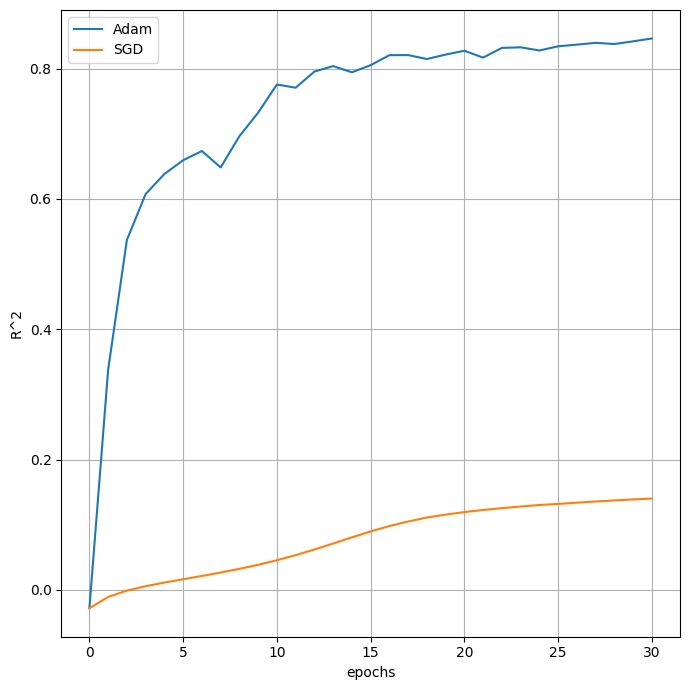

In [ ]:
# análisis de algorítmo de optimización 
batch_size = 256
epochs = 30
neurons = 64 
capas = 3
lr = 5e-4

fig, axs = plt.subplots(1,1, figsize=(7,7))

df_encoded, scaler = encode_df(df, scaling_label=True)
# dividir en entrenamiento y test
X_train, X_test, y_train, y_test, device = make_X_y(df_encoded)
features = X_train.shape[1]

for opt_alg in ['Adam', 'SGD']:
    torch.manual_seed(42)
    model_order = [
        ("input", nn.Linear(features, neurons))
    ]
    for i in range(3):
        model_order.append((f"GLU_{i}", nn.GLU()))
        model_order.append((
            f"linear_{i}", 
            nn.Linear(
                neurons // 2,
                neurons
            )
        ))
    model_order.append((f"GLU_{i+1}", nn.GLU()))

    model_order.append((f"output", nn.Linear(neurons//2, 1)))

    model = nn.Sequential(OrderedDict(model_order)).to(device)
    print(model)
    total_params = sum(p.numel() for p in model.parameters())
    print(f"Total parameters to learn: {total_params}")
    ds = TensorDataset(X_train, y_train)
    g = torch.Generator()
    g.manual_seed(17)
    dl = DataLoader(ds, batch_size=batch_size, shuffle=True, drop_last=False, generator=g)

    if opt_alg == 'Adam':
        opt = torch.optim.Adam(model.parameters(), lr=lr)
    elif opt_alg == 'SGD':
        opt = torch.optim.SGD(model.parameters(), lr=lr)
    # mse_loss = nn.MSELoss()
    
    start_time = time.perf_counter()
    loss_hist, r2_hist = train_model(model, epochs, 'RMSE', dl, opt, X_val=X_test, y_val=y_test)
    end_time = time.perf_counter()
    print(f"Elapsed time: {(end_time-start_time):.3f}s")
    test_model(model=model, loss='RMSE', X_test=X_test, y_test=y_test)

    axs.plot(
        r2_hist, 
        label=f"{opt_alg}",
        # color = colors[act_fun]
    )
    
axs.set_xlabel('epochs')
axs.set_ylabel('R^2')
axs.grid()
axs.legend()

plt.tight_layout()
plt.show()

Sequential(
  (input): Linear(in_features=8, out_features=64, bias=True)
  (GLU_0): GLU(dim=-1)
  (linear_0): Linear(in_features=32, out_features=64, bias=True)
  (GLU_1): GLU(dim=-1)
  (linear_1): Linear(in_features=32, out_features=64, bias=True)
  (GLU_2): GLU(dim=-1)
  (linear_2): Linear(in_features=32, out_features=64, bias=True)
  (GLU_3): GLU(dim=-1)
  (output): Linear(in_features=32, out_features=1, bias=True)
)
Total parameters to learn: 6945
Training model...
Training finished!
Elapsed time: 121.634s
RMSE=0.8497  R2=0.2806


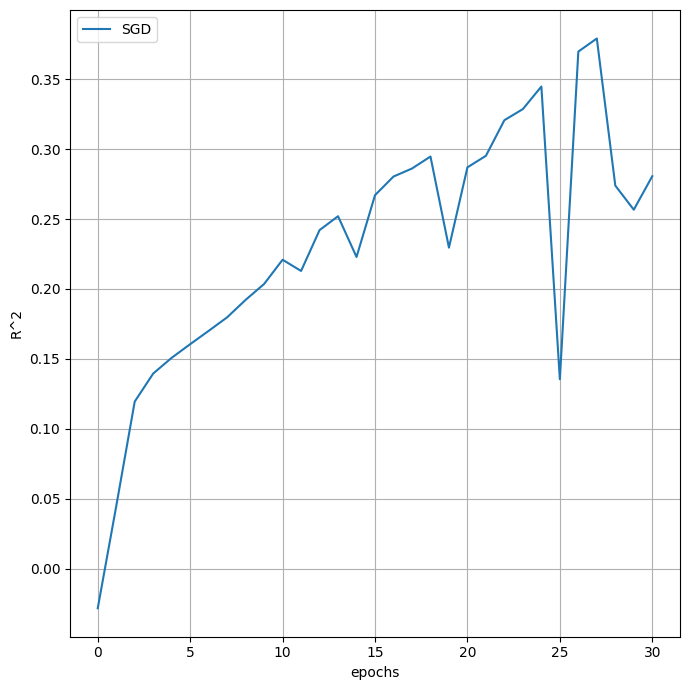

In [180]:
# analizo SGD con otro lr
batch_size = 256
epochs = 30
neurons = 64 
capas = 3
lr = 5e-3

fig, axs = plt.subplots(1,1, figsize=(7,7))

df_encoded, scaler = encode_df(df, scaling_label=True)
# dividir en entrenamiento y test
X_train, X_test, y_train, y_test, device = make_X_y(df_encoded)
features = X_train.shape[1]

for opt_alg in ['SGD']:
    torch.manual_seed(42)
    model_order = [
        ("input", nn.Linear(features, neurons))
    ]
    for i in range(3):
        model_order.append((f"GLU_{i}", nn.GLU()))
        model_order.append((
            f"linear_{i}", 
            nn.Linear(
                neurons // 2,
                neurons
            )
        ))
    model_order.append((f"GLU_{i+1}", nn.GLU()))

    model_order.append((f"output", nn.Linear(neurons//2, 1)))

    model = nn.Sequential(OrderedDict(model_order)).to(device)
    print(model)
    total_params = sum(p.numel() for p in model.parameters())
    print(f"Total parameters to learn: {total_params}")
    ds = TensorDataset(X_train, y_train)
    g = torch.Generator()
    g.manual_seed(17)
    dl = DataLoader(ds, batch_size=batch_size, shuffle=True, drop_last=False, generator=g)

    if opt_alg == 'Adam':
        opt = torch.optim.Adam(model.parameters(), lr=lr)
    elif opt_alg == 'SGD':
        opt = torch.optim.SGD(model.parameters(), lr=lr)
    # mse_loss = nn.MSELoss()
    
    start_time = time.perf_counter()
    loss_hist, r2_hist = train_model(model, epochs, 'RMSE', dl, opt, X_val=X_test, y_val=y_test)
    end_time = time.perf_counter()
    print(f"Elapsed time: {(end_time-start_time):.3f}s")
    test_model(model=model, loss='RMSE', X_test=X_test, y_test=y_test)

    axs.plot(
        r2_hist, 
        label=f"{opt_alg}",
        # color = colors[act_fun]
    )
    
axs.set_xlabel('epochs')
axs.set_ylabel('R^2')
axs.grid()
axs.legend()

plt.tight_layout()
plt.show()

#### Modelo final a utilizar
En función de los análisis hechos previamente concluimos utilizar el siguiente modelo:
- `RMSE` como función de pérdida
- Adam como algorítmo de optimización
- learning rate 4E-5
- `GLU` como la función de activación de todas las capas neuronales
- 3 capas neuronales
- 64 neuronas por capas
- batch size de 300 
- 150 epochs de entrenamiento

Sequential(
  (input): Linear(in_features=8, out_features=64, bias=True)
  (GLU_0): GLU(dim=-1)
  (linear_0): Linear(in_features=32, out_features=64, bias=True)
  (GLU_1): GLU(dim=-1)
  (linear_1): Linear(in_features=32, out_features=64, bias=True)
  (GLU_2): GLU(dim=-1)
  (linear_2): Linear(in_features=32, out_features=64, bias=True)
  (GLU_3): GLU(dim=-1)
  (output): Linear(in_features=32, out_features=1, bias=True)
)
Total parameters to learn: 6945
Training model...
Training finished!
RMSE=0.3127  R2=0.9026


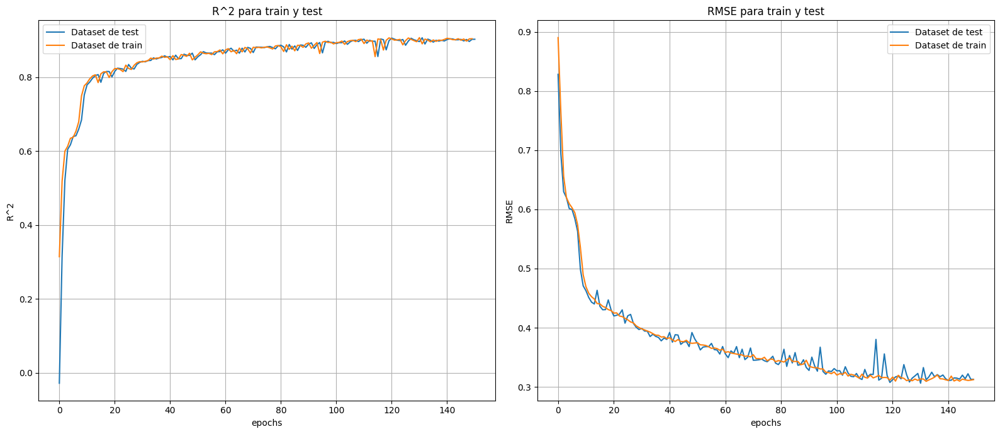

In [177]:
# Modelo Final
batch_size = 300
epochs = 150
neurons = 64
capas = 3
lr = 5e-4

fig, axs = plt.subplots(1,2, figsize=(16,7))

df_encoded, scaler = encode_df(df, scaling_label=True)
# dividir en entrenamiento y test
X_train, X_test, y_train, y_test, device = make_X_y(df_encoded)
features = X_train.shape[1]


torch.manual_seed(42)
model_order = [
    ("input", nn.Linear(features, neurons))
]
for i in range(capas):
    model_order.append((f"GLU_{i}", nn.GLU()))
    model_order.append((
        f"linear_{i}", 
        nn.Linear(
            neurons // 2,
            neurons
        )
    ))
model_order.append((f"GLU_{i+1}", nn.GLU()))

model_order.append((f"output", nn.Linear(neurons//2, 1)))


model = nn.Sequential(OrderedDict(model_order)).to(device)
print(model)
total_params = sum(p.numel() for p in model.parameters())
print(f"Total parameters to learn: {total_params}")
ds = TensorDataset(X_train, y_train)
g = torch.Generator()
g.manual_seed(17)
dl = DataLoader(ds, batch_size=batch_size, shuffle=True, drop_last=False, generator=g)

opt = torch.optim.Adam(model.parameters(), lr=lr)
# mse_loss = nn.MSELoss()

loss_hist_test, r2_hist_test, loss_hist_train, r2_hist_train = train_model(model, epochs, 'RMSE', dl, opt, X_val=X_test, y_val=y_test, X_train=X_train, y_train=y_train, train_hist=True)
test_model(model, 'RMSE', X_test, y_test)

axs[0].plot(
    r2_hist_test, 
    label=f"Dataset de test",
)
axs[0].plot(
    r2_hist_train, 
    label=f"Dataset de train",
)
axs[0].set_xlabel('epochs')
axs[0].set_ylabel('R^2')
axs[0].grid()
axs[0].legend()
axs[0].set_title('R^2 para train y test')

axs[1].plot(
    loss_hist_test, 
    label=f"Dataset de test",
)
axs[1].plot(
    loss_hist_train, 
    label=f"Dataset de train",
)
axs[1].set_xlabel('epochs')
axs[1].set_ylabel('RMSE')
axs[1].grid()
axs[1].legend()
axs[1].set_title('RMSE para train y test')

plt.tight_layout()
plt.show()

### 2c) Evaluación del Modelo (1 punto)
- Graficar las evoluciones por época de la función de costo y del $R^2$, tanto para el set de train como el de validation.
- Gráfica scatter de Real VS Predicho en el set de validation.
- Explicar el proceso de iteracion utilizado para conseguir los mejores resultados y justificar los resultados obtenidos.
- Un resultado aceptable sería un $R^2$ de al menos 0.55 para el set de validation.

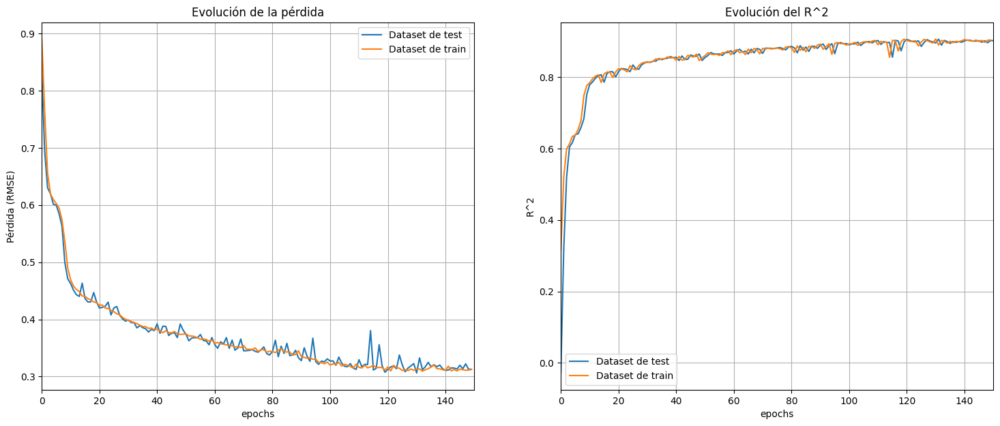

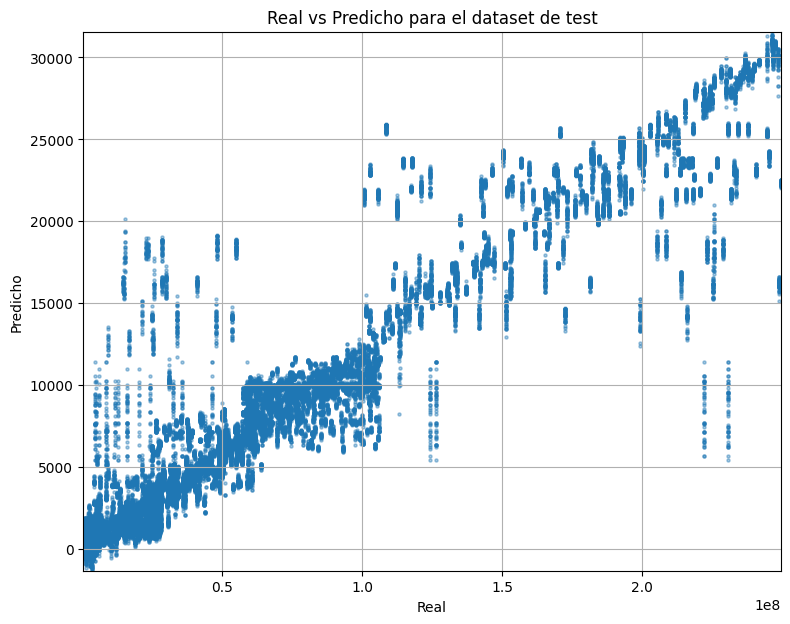

In [ ]:
fig, axs = plt.subplots(1,2,figsize=(18,7))

axs[0].plot(loss_hist_test, label="Dataset de test")
axs[0].plot(loss_hist_train, label="Dataset de train")
axs[0].set_title('Evolución de la pérdida')
axs[0].set_ylabel('Pérdida (RMSE)')
axs[0].set_xlabel('epochs')
axs[0].grid()
axs[0].set_xlim(0,epochs)
axs[0].legend()

axs[1].plot(r2_hist_test, label="Dataset de test")
axs[1].plot(r2_hist_train, label="Dataset de train")
axs[1].set_title('Evolución del R^2')
axs[1].set_ylabel('R^2')
axs[1].set_xlabel('epochs')
axs[1].grid()
axs[1].set_xlim(0,epochs)
axs[1].legend()

plt.show()

model.eval()
with torch.no_grad():
    yhat = model(X_test)

y_test_np, yhat_np = y_test.to('cpu'), yhat.to('cpu')
y_test_np, yhat_np = scaler.inverse_transform(y_test_np), scaler.inverse_transform(yhat_np)
fig, axs = plt.subplots(1,1, figsize=(9,7))
axs.scatter(y_test_np, yhat_np, s=5, alpha=0.4)
axs.plot(y_test_np, y_test_np, color='k')
axs.set_xlabel("Real")
axs.set_ylabel("Predicho")
axs.grid()
axs.set_xlim(y_test.min(), y_test.max())
axs.set_ylim(yhat.min(), yhat.max())
axs.set_title("Real vs Predicho para el dataset de test")

plt.show()

Repasemos el proceso por el cual llegamos a este modelo:
- Evaluamos la performance de escalar o no escalar el label previo al entrenamiento del modelo. Se concluyó que escalar el label 'Purchase' permite una mejor performance.
- Evaluamos qué función de activación daba mejor respuesta. El ganador claro de esta comparación fue la función `GLU`.
- Analizamos si combinar `GLU` con `LeakyReLU` podría darnos algún beneficio, y llegamos a la conclusión de que no.
- Probamos aumentar la cantidad de capas de 3 a 6 capas, y obtuvimos que el comportamiento del modelo no mejora agregando más capas a igual cantidad de neuronas.
- Evaluamos como escala el modelo al aumentar la cantida de neuronas por capa. Llegamos a la conclusión de que un número óptimo de neuronas por capa es 64, y que además no se penaliza el aumento de cantidad de neuronas en tiempo de cómputo.
- Analizamos el efecto del tamaño de batch sobre el entrenamiento, concluyendo utilizar 300 para equilibrar performance y tiempo de cómputo.
- Analizamos durante cuantas epochs es productivo dejar al modelo entrenando. La conclusión fue que a partir de 100 epochs la ganancia es marginal.
- Se analizó si utilizar una función de pérdida distinta a `RMSE` podía ser beneficioso, concluyendo que `RMSE` continua siendo la mejor alternativa.
- Se evaluó utilizar Stochastic Gradient Descent como algorítmo de optimización en lugar de Adam, pero se obtuvo una convergencia muy lenta para el learning rate establecido previamente. Se analiza si modificar ese valor podría lograr una performance similar a Adam, pero se concluye que no se obtiene una mejora apreciable respecto de este último.


Se obtiene un muy buen valor de $R^2=0.9026$ y de $RMSE=0.3127$, estando bien por encima de la aceptación $R^2=0.55$.

### 2d) Conclusiones finales (0.5 puntos)
Redactar de manera detallada las conclusiones finales y si se cumplió con el objetivo o no.

En primer lugar podemos concluir que se cumplió sobradamente con el objetivo propuesto de $R^2>0.55$.

Por otro lado, tenemos que, en mi opinión, la clave del éxito de este modelo radicó en 2 decisiones: el uso de un escalado para el label, y el uso de la función de activación `GLU`. Ambas decisiones mostraron ser muy superiores a las alternativas en sus respectivos análisis.

Un resultado interesante es que el modelo no logra mejorar al aumentar las capas neuronales, ni tampoco logra mucha mejora al aumentar las neuronas por cada. Esto no indica que se encuentra al tope de la performance que nos puede entregar este modelo.

En cuanto al algorítmo de optimización, Adam logra una performance muy buena y SGD no así. Esto último puede deberse a que al estar la inicialización de parámetros fija para garantizar reproducibilidad, si se cayó en un punto inicial no favorable a SGD, va a ser dificil salir de los mínimos locales en búsqueda de un mínimo global.